In [1]:
import os 
# going to root directory (if not there yet)
current_dir = os.getcwd().split('/')[-1]
if current_dir != 'pixelNMF': 
    os.chdir('..')

## TODO:

- ADD/CORRECT interspike interval correct
- ADD/CORRECT peak width 
- ADD/CORRECT no. of components --> better decoding ? keep min ? also fix cross val excel output save of min
- CORRECT peak detection for frequency (2sds usually used for frequency estimation--> based on normal distribution and p-values of significance)
- REVIEW/CORRECT overlap 
- make into runnable module -- > github

In [2]:
from scipy.signal import find_peaks, peak_widths
import seaborn as sns

from scipy import stats
from scipy.stats import gaussian_kde
from scipy.stats import linregress
import tifffile 
import matplotlib.animation as animation
from scipy.ndimage import gaussian_filter1d

# standard libraries
import numpy as np
import imageio
import matplotlib.pyplot as plt 
!pip install spicy
from scipy.ndimage import center_of_mass
from scipy.signal import find_peaks
!pip install umap-learn
from umap import UMAP

# import matplotlib.pyplot as plt
from sklearn.decomposition import NMF
from openTSNE import TSNE
from rastermap import Rastermap, utils 
from scipy.spatial.distance import pdist, squareform

# custom libraries 
from patchnmf.preprocessing import *
from patchnmf.data_io import *
from patchnmf.analyse.compute import *
from patchnmf.plot import *
#from patchnmf.analyse.compute import downsample_tiff_avg, compute_nmfpx_blur_thr_std, get_thr_img_auto_std, get_roi_conts, compute_iou, compute_centroids, get_pixel_indices_for_centroids, get_norm_comp_number, is_border_touching
# from patchnmf.plot import plot_nmfpx_blur_thr, plot_roi_conts_largest, plot_roi_area_hist, plot_nmf_corr_mat, plot_nmf_thresholds, plot_rois_auto_centroids, plot_rois_scatters, plot_rois_contours

    
# reload code if library changes
%load_ext autoreload
%autoreload 2
%reload_ext autoreload


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


C:\Users\zaggila\Anaconda3\envs\pixelNMF\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# Add:

# W size (segregation idx + contours (polycontour) size (on bin or non bin)
# Identify classes of patterns --> later on correlate the W large to motion (I hypothesize they should be correlated)
# Identify small and big patterns --> compute their occurence in Active/Sleep periods --> sleep: twicth related 

# include computing peak width correcly 

In [4]:
def mkdir(path):
    if not os.path.exists(path): os.makedirs(path)
    return path 

## Define dataset

In [5]:
ds = 'sz119/2025_06_08_a'

In [6]:
save_versions_NMF = 'nmf_final'
save_dir = mkdir(f'data_proc/pixels/{ds}')
save_dir_NMF = mkdir(f'{save_dir}/NMF')
save_dir_NMF = mkdir(f'{save_dir_NMF}/{save_versions_NMF}')

In [7]:
print(save_dir)

data_proc/pixels/sz119/2025_06_08_a


# if cropping all motions artifact, rerun preprocessing becs npy need to be updated

In [8]:
#load preprocessed tiff
data = get_numpy(ds)

 Data shape : (5400, 12769)


## load params

In [9]:
ds = 'sz119_2025_06_08_a'

In [10]:
pixelnmf_params = r'C:/Users/zaggila/Documents/pixelNMF/data_proc/pixelnmf_params.xlsx'

In [11]:
params_table, genotype, blur_std, downs_fact, res_orig, x_axis, y_axis, original_FOV, framerate, duration, resolution, time_per_frame, n_components_elbow, n_components_min, age, weight_g, s2p, cells, Behaviour, mousecraft, SLEAP = read_params(pixelnmf_params, ds)

,Parameter,Value
0,genotype,EMX
1,blur_std,1.500000
2,downs_fact,10
3,res_orig,1.102000
4,x_axis,113.000000
5,y_axis,113.000000
6,original_FOV,1128.000000
7,framerate,15.000000
8,duration,1800
9,resolution,9.982301


In [12]:
# invesre xy for sz15 sz14 nit coming from x y dims in excel
# y_axis=55

## manual x y inversion if nmf output is inverted

In [13]:
resolution

9.982300884955752

##  to do 

1. (done) adjust min threshold for frequency (becs too infrequent comps should also be exlcuded ad too frequent)
2. (later todo) add sce detection as in Avitan 2017
3.  (later todo) also if sum pix and temp trace corr enought, keep if not discard ? for distance analysis for correlated k-H-Sum only compute
##  important:! If std peak detection is passed, still can discard bad comps in time if iei too small.(or too high) check that this is happening correctly!!!
#exclude if both space and time bad

## Setting magic numbers 

In [14]:
iei_threshold = 0.05 # for IEIs computation on temporal traces
frequency_max_thresh = 0.03 #if frequency higher, discard component from frequency detection, iei.. what else, check.
frequency_min_thresh = 0.007
# n_components = int(n_components_elbow)
n_components = 15

In [15]:
movie_shape = (data.shape[0], int(x_axis), int(y_axis))

print(movie_shape)

(5400, 113, 113)


## saving dirs

In [16]:
# zscoring for sz34, if not dont detrend issue may be coming from there

In [17]:
save_dir

'data_proc/pixels/sz119/2025_06_08_a'

In [18]:

# data= zscore(data,axis=0)
# data = data + abs(np.min(data))
# data.min()

# import tifffile
# # Reshape the normalized image 
# reshaped_tiff_preprocessed_zscored = data.reshape(data.shape[0], x_axis, y_axis)

# output_filename = r'C:\Users\zaggila\Documents\pixelNMF\data\sz34_2022-05-12_a\tiff.tiff'
# tifffile.imwrite(output_filename, reshaped_tiff_preprocessed_zscored)

## NMF

In [19]:
print(f' NMF will run for n_components: {n_components}')

 NMF will run for n_components: 15


In [20]:
#initialising nmf and fitting to pixels, read n_components from cv_nmf

model = NMF(n_components=n_components, verbose=True, max_iter=10000) #tried playing max_iter does not change much, convergence depends on the dataset complexity

H = model.fit_transform(data) # temporal traces

W = model.components_ # pixel weights (spatial comps) 

print(f'W shape is {W.shape}')
print(f'H shape is {H.shape}')

violation: 1.0
violation: 0.22513306436656905
violation: 0.09856088231264949
violation: 0.0632513161181909
violation: 0.05553003372552963
violation: 0.04746559428438624
violation: 0.03838878520257477
violation: 0.031166856352386182
violation: 0.028853719617098133
violation: 0.02925560824544311
violation: 0.029096729401837162
violation: 0.027239700054979103
violation: 0.0240156310912188
violation: 0.020289367607201104
violation: 0.01677029822255721
violation: 0.013902044398928186
violation: 0.011548943640823449
violation: 0.009546972210147385
violation: 0.007913631267249421
violation: 0.006562137237080997
violation: 0.005474328848846213
violation: 0.004603134638474454
violation: 0.003892780937760772
violation: 0.0033130401321290006
violation: 0.002833462052123703
violation: 0.002435290133621851
violation: 0.002097034190960335
violation: 0.0018105950242816784
violation: 0.0015641163926904543
violation: 0.0013575687080532002
violation: 0.001180175222317032
violation: 0.0010293992670444372

## Get raw NMFs, smoothed and binary (2sd)


Excluding big objects 
Excluding too small objects 

Define max size in pxs and get a min percentage for min_mask_threshold

-- added 0-1 normalization on loading_img (raw nmf)

-- added adapted percentage based min threshold for binarisation

In [21]:
# here we get the raw NMF component on pixels, raw NMF with gaussin blur and an automatically thresholded blurred NMF (binary 'ROI')
# loading_imgs, loading_imgs_filt, rois_auto, std_thresholds = compute_nmfpx_blur_thr_std(model, movie_shape, blur_std=blur_std, min_size=int(percentage(3, max_px_size)))

## Set min max sizes for pattern filtering

In [22]:
total_area = x_axis * y_axis * (resolution**2)
print(f'Total_area is {total_area}')

min_size = int(percentage(3, total_area))
print(f'Min_size is {min_size}')

max_size = int(percentage(60, total_area))
print(f'Max_size is {max_size}')

min_size_comp = int(percentage(0.01, total_area))
print(f'Max_size of pattern is {min_size_comp}')

Total_area is 1272383.9999999998
Min_size is 38171
Max_size is 763430
Max_size of pattern is 127


## Here min_size is only used for visualisation (thresholds bin mask that will be displayed)
-- The thershold i set for filtering is 2 % of total area
and for computing (like transfrorming, smoothying (could also be some transformation) i set to 0.01 %)

In [23]:
x_axis
y_axis*x_axis

12769.0

In [24]:
loading_imgs, loading_imgs_filt, rois_auto, std_thresholds = compute_nmfpx_blur_thr_std(model, movie_shape, blur_std=1.5, min_size=min_size_comp)

In [25]:
# # Apply exclusion across all relevant variables
# valid_inds = [i for i in range(W.shape[0]) if i!=4]
# W = W[valid_inds, :]
# H = H[:, valid_inds]
# loading_imgs = [loading_imgs[i] for i in valid_inds]
# loading_imgs_filt = [loading_imgs_filt[i] for i in valid_inds]
# rois_auto = [rois_auto[i] for i in valid_inds]  # If rois_auto is a list
# std_thresholds = [std_thresholds[i] for i in valid_inds]

# n_components = len(std_thresholds)

## Plot some visuals

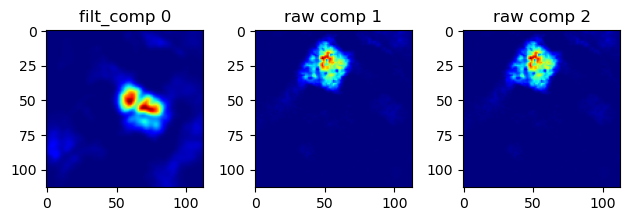

In [26]:
fig, axs = plt.subplots(1,3)

axs[0].imshow(loading_imgs_filt[0], cmap='jet')
axs[0].set_title('filt_comp 0')

axs[1].imshow(loading_imgs[4], cmap='jet')
axs[1].set_title('raw comp 1')

axs[2].imshow(loading_imgs[4], cmap='jet')  # Plot third image (adjust index if needed)
axs[2].set_title('raw comp 2')

plt.tight_layout()
plt.show()

Saving nmfpx_blur_thr.png ...


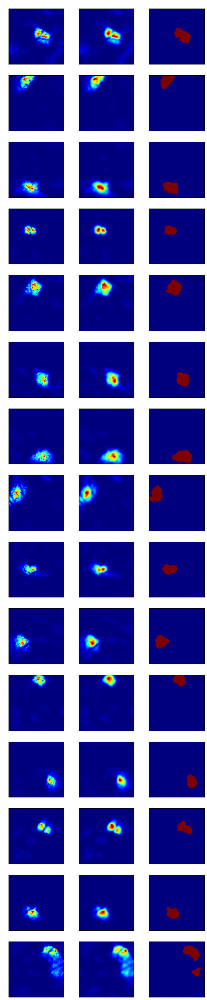

In [27]:
plot_nmfpx_blur_thr(loading_imgs, loading_imgs_filt, rois_auto, title='pre_filtering', save_dir=save_dir_NMF)

## plot the thresholds used 

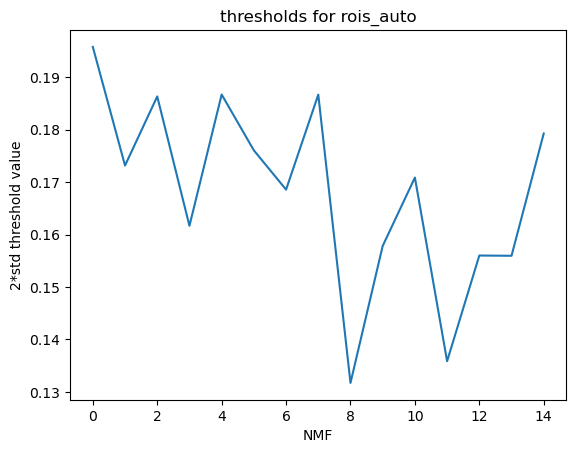

In [28]:
plot_nmf_thresholds(std_thresholds, save_dir=save_dir_NMF)

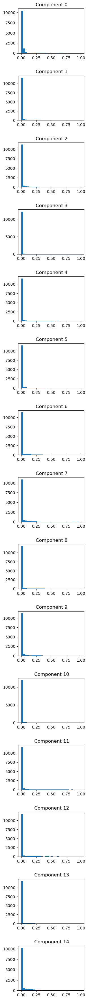

In [29]:
fix, axs = plt.subplots(n_components, 1, figsize=(3,n_components*3))

for i in range(n_components):
    axs[i].hist(loading_imgs[i].reshape(-1), bins=30)
    axs[i].set_title(f' Component {i}')

plt.subplots_adjust(hspace=0.5)  
plt.savefig(os.path.join(save_dir_NMF, f'hist_comp_{i} pre_filtering'), bbox_inches='tight')
plt.show()

## Sanity check: Plot rasterplot vs reconstructed rasterplot

In [30]:
data.shape

(5400, 12769)

In [31]:
# zdata = zscore(data, axis=0)

In [32]:
sorted_data = sort_by_pc1(data, component=0)
sorted_data.shape

(5400, 12769)

In [33]:
reconstructed_data = reconstruct_data(W.T, H.T, data)
sorted_reconstructed_data = sort_by_pc1(reconstructed_data.T, component=0)

In [34]:
sorted_reconstructed_data.max()

0.8457784260702369

In [35]:
sorted_data.max()

0.7711753340239698

In [36]:
sorted_reconstructed_data.min()

0.0

In [37]:
sorted_reconstructed_data.max()

0.8457784260702369

In [38]:
np.percentile(sorted_data,99)

0.06604627034555081

vmin: 0.0, vmax: 0.06604627034555081, min value: 0.0, max value: 0.7711753340239698


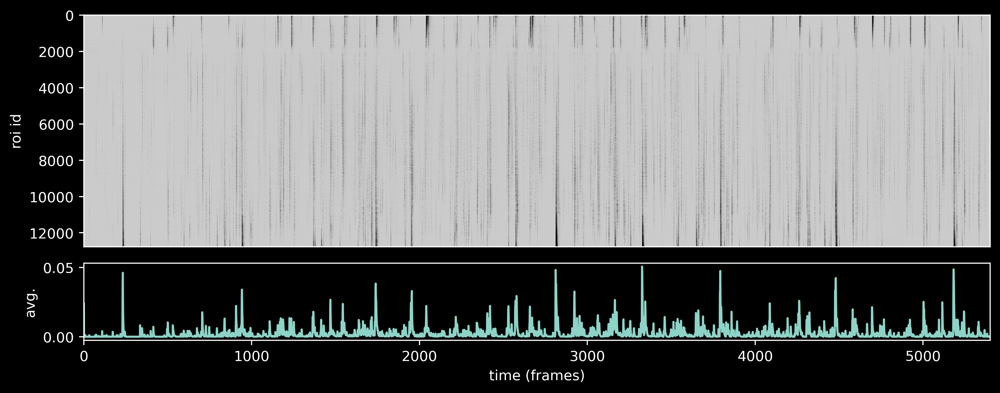

In [39]:
plot_acts(sorted_data, title='original data', cmap='gray_r', style='dark', save_dir=save_dir_NMF, save=True)

vmin: 0.0, vmax: 0.048689261501572524, min value: 0.0, max value: 0.8457784260702369


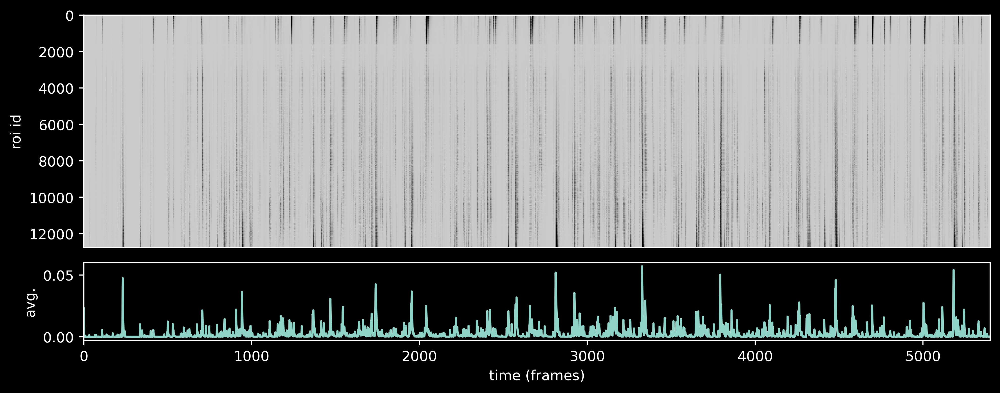

In [40]:
plot_acts(sorted_reconstructed_data, title='reconstructed data', cmap='gray_r', style='dark', save_dir=save_dir_NMF, save=True)

In [41]:
import os
import numpy as np
import matplotlib.pyplot as plt

def plot_acts(data, title='', ds=None, save_dir=None, save=True, motion_smooth=True):
    """
    Plot neural activity and optionally motion energy from dataset path `ds`.

    Parameters:
    - data: 2D array (time x rois or pixels)
    - title: Plot title
    - ds: str, relative dataset path like 'pixels/sz116/2025_06_07_a'
    - save_dir: path to save plots
    - save: whether to save plot
    - motion_smooth: apply smoothing to motion trace if loaded
    """

    # Try loading motion energy if dataset path is given
    motion = None
    if ds is not None:
        motion_path = os.path.join(ds, 'motion_energy.npy')
        if os.path.exists(motion_path):
            motion = np.load(motion_path)
            print(f"✅ Loaded motion energy: {motion_path} | shape: {motion.shape}")
            if motion_smooth:
                motion = np.convolve(motion, np.ones(5)/5, mode='same')
        else:
            print(f"⚠️ Motion energy not found: {motion_path}")

    # Plot
    has_motion = motion is not None
    nrows = 3 if has_motion else 2
    fig, axs = plt.subplots(nrows, 1, figsize=(10, 5 if has_motion else 4), dpi=400, 
                            gridspec_kw={'height_ratios': [3, 1, 1][:nrows]})

    # Main activity heatmap
    axs[0].imshow(data.T, cmap='gray_r', aspect='auto', 
                  vmin=np.percentile(data, 1), vmax=np.percentile(data, 95), alpha=0.8)
    axs[0].xaxis.set_visible(False)
    axs[0].set_ylabel('ROI')
    axs[0].set_title(title, fontsize=14)

    # Avg activity trace
    axs[1].plot(np.mean(data, axis=1), label='Avg. activity')
    axs[1].set_xlim(0, data.shape[0])
    axs[1].set_ylabel('Avg.')
    axs[1].set_xlabel('Time (frames)')

    # Motion energy trace if available
    if has_motion:
        axs[2].plot(motion, color='orange', label='Motion energy')
        axs[2].set_xlim(0, len(motion))
        axs[2].set_ylabel('Motion')
        axs[2].set_xlabel('Time (frames)')
        axs[2].legend(loc='upper right', fontsize=8)

    plt.tight_layout()

    if save and save_dir:
        os.makedirs(save_dir, exist_ok=True)
        fname = os.path.join(save_dir, f'acts_{title}.png')
        plt.savefig(fname, bbox_inches='tight')
        plt.close(fig)
    else:
        plt.show()


⚠️ Motion energy not found: sz119_2025_06_08_a\motion_energy.npy


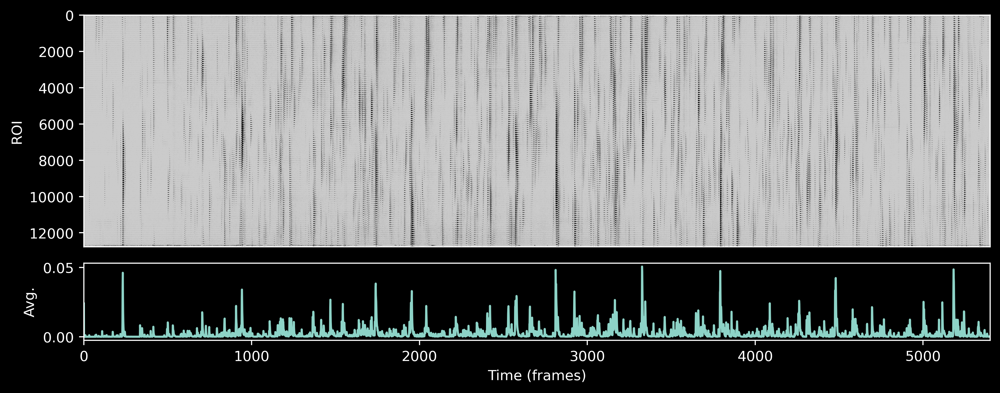

In [42]:
plot_acts(data, title='', ds=ds, save_dir=None, save=True, motion_smooth=True)

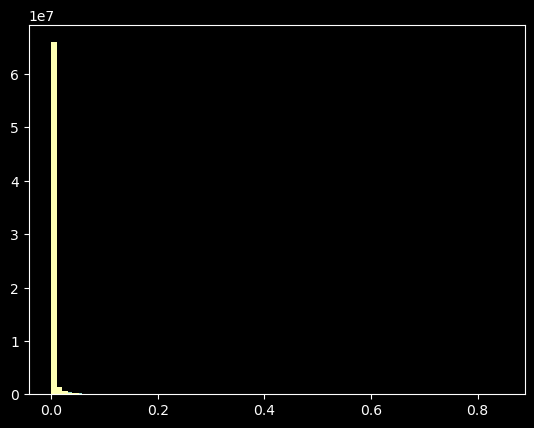

In [43]:
plt.hist(sorted_data.flatten(), bins=80)
plt.hist(sorted_reconstructed_data.flatten(), bins=80)
plt.show()

# Filter rois and keep only filtered_rois_auto smaller than max threshold and bigger than min thershold

-- Compute size of all filtered_rois_auto (filtered 'good'patterns)

In [44]:
all_roi_areas, filtered_rois_auto, filtered_rois_idxs, filtered_loading_imgs, filtered_loading_imgs_filt = get_all_filtered_roi_areas(rois_auto, loading_imgs, loading_imgs_filt, x_axis, y_axis, total_area, min_size, max_size, res=resolution)
print(f' The remaining rois after filtering are {len(filtered_rois_auto)}')

 The remaining rois after filtering are 14


In [45]:
len(filtered_loading_imgs)
len(filtered_loading_imgs_filt)

14

In [46]:
print("Filtered ROIs Indices:", filtered_rois_idxs)

Filtered ROIs Indices: [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


In [47]:
rois_auto = filtered_rois_auto

## plot W before and H before and then here plot w h after filtering 

BUG TO FIX§§§ MISMATCH IN IDXING OF RAX AND SMOOTHED VS BIN

In [48]:
all_roi_areas

[65666.93210118254,
 56399.82332210822,
 61780.725193828795,
 70051.37066332523,
 59787.79857467303,
 77126.2601613282,
 62577.8958414911,
 46634.48288824496,
 52712.909076670054,
 45339.080585793716,
 45638.01957866708,
 49723.5191479364,
 46933.421881118324,
 84300.79599028897]

Saving nmfpx_blur_thr.png ...


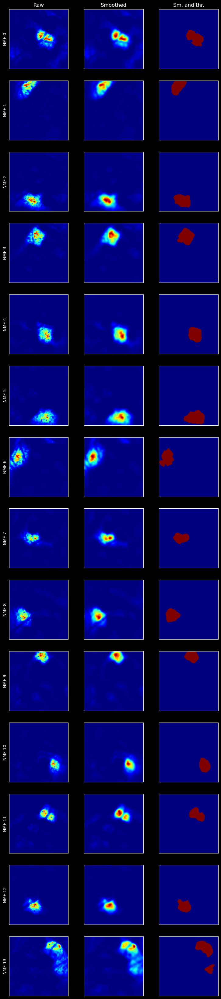

In [49]:
plot_nmfpx_blur_thr(filtered_loading_imgs, filtered_loading_imgs_filt, filtered_rois_auto, title='post_filtering', save_dir=save_dir_NMF)

In [50]:
n_components

15

In [51]:
len(filtered_rois_auto)

14

## Get normalized no. of patterns per 500 squared um 

In [52]:
cropped_FOV_area = x_axis*y_axis *100
desired_FOV_area = 500**2

norm_components= len(filtered_rois_auto) * (desired_FOV_area)/ (cropped_FOV_area)
print(norm_components)

2.7410133918082855


## for seed corrs needs idx of rois auto 20 if not out of idx errror

In [53]:
rois_auto = filtered_rois_auto

In [54]:
len(all_roi_areas)
np.mean(all_roi_areas)

58905.216786189754

In [55]:
def get_non_border_roi_areas(rois_auto, resolution, x_axis, y_axis):
    """
    Compute the areas of non-border ROIs and exclude those larger than a certain size.
    """
    # Total area of the field of view (FOV)
    total_area = x_axis * y_axis * (resolution ** 2)
    
    # Set a max allowed size threshold (e.g., 50% of the total area)
    max_size = 0.6 * total_area
    
    # Exclude ROIs that touch the borders
    non_border_rois_auto = [roi for roi in rois_auto if not is_border_touching(roi, x_axis, y_axis)]
        
    non_border_roi_areas = []

    # Loop through non-border ROIs and calculate area
    for roi in non_border_rois_auto:
        # Compute the area of the ROI
        roi_area = np.sum(roi) * (resolution ** 2)  # Sum of pixels * resolution^2 gives the area

        # Exclude ROIs that are larger than the max allowed size
        if roi_area <= max_size:
            non_border_roi_areas.append(roi_area)

    return non_border_roi_areas



def get_all_roi_areas(rois_auto, res = resolution): 
    
    all_roi_areas = [np.sum(roi)*(resolution**2) for roi in rois_auto] #this should handle multiple object patterns, computes the size of both 

    return all_roi_areas

from scipy.ndimage import label

def get_all_roi_areas_disconnected(rois_auto, res=resolution):
    """
    Calculate the areas of disconnected regions (objects) in each binary ROI mask.

    Parameters:
    - rois_auto: List of binary masks (2D numpy arrays) representing the ROIs
    - res: The resolution, or size of one side of the pixel in micrometers (default is 10 μm in downsampled)
    
    Returns:
    - all_roi_areas: List of lists where each sublist contains the areas of individual objects
                     (in square micrometers) for each ROI
    """
    all_roi_areas_disconnected = []
    
    for roi in rois_auto:
        # Label connected components in the binary mask
        labeled_roi, num_features = label(roi)
        
        # List to store areas of each disconnected object in this ROI
        roi_areas = []
        
        for i in range(1, num_features + 1):  # labels start from 1 (0 is background)
            # Find the area of each labeled object
            object_area = np.sum(labeled_roi == i) * (res ** 2)  # Multiply by pixel area (res^2)
            roi_areas.append(object_area)
        
        # Append the list of areas for this ROI to the overall result
        all_roi_areas_disconnected.append(roi_areas)
    
    return all_roi_areas_disconnected
    
def plot_roi_areas_borders_out(roi_areas_borders_out, n_bins=20, alpha=0.5, save_dir=save_dir_NMF):
    
    plt.figure()
    plt.hist(non_border_roi_areas, bins=n_bins, alpha=alpha)
    plt.title('Patch area (excluding borderline patches)')
    plt.xlabel('Area (um^2)')
    plt.ylabel('Frequency')

    plt.show()


def plot_all_roi_areas(rois_auto, bins=None, alpha=0.5, save_dir=save_dir_NMF):
    
    plt.figure()
    plt.hist(all_roi_areas, alpha=alpha)
    plt.title('Patch area (including borderline patches)')
    plt.xlabel('Area (um^2)')
    plt.ylabel('Count')

    plt.show()

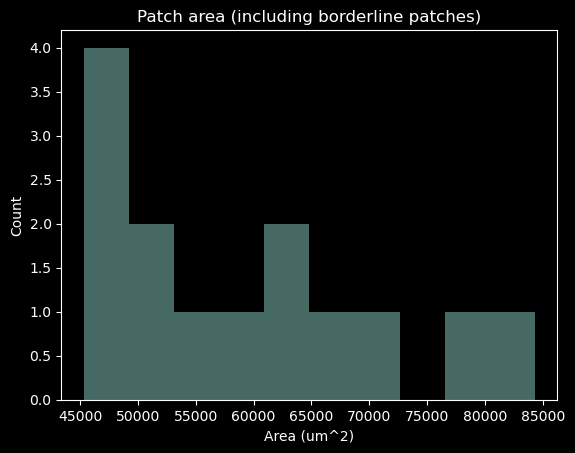

58905


In [56]:
plot_all_roi_areas(all_roi_areas, bins=3) #of filtered rois 

mean_area_all = int(np.mean(all_roi_areas))
print(mean_area_all)

## get the area of separate objects (multiple assembly patterns) separately


In [57]:
all_roi_areas_disconnected = get_all_roi_areas_disconnected(rois_auto, res=resolution)
print(all_roi_areas_disconnected)

[[65666.93210118254], [56399.82332210822], [61780.725193828795], [70051.37066332523], [59787.79857467303], [77126.2601613282], [62577.8958414911], [46634.48288824496], [52712.909076670054], [45339.080585793716], [45638.01957866708], [49723.5191479364], [46933.421881118324], [63773.651812984564, 20527.144177304406]]


## plot pattern area (excluding border-touching patterns) (maybe more of a correct area description)

# 1. Compute and get mean 
# 2. Plot

In [58]:
def is_border_touching(roi, y_axis_FOV, x_axis_FOV):
    if isinstance(roi, tuple):
        roi = roi[1]
    if not isinstance(roi, np.ndarray):
        raise ValueError(f"Expected roi to be a NumPy array, got {type(roi)}")
    if roi.ndim != 2:
        raise ValueError(f"Expected 2D roi, got shape {roi.shape}")

    height, width = roi.shape  # Use actual roi shape, not external x_axis/y_axis
    return (
        np.any(roi[0, :]) or
        np.any(roi[:, 0]) or
        np.any(roi[height - 1, :]) or
        np.any(roi[:, width - 1])
    )

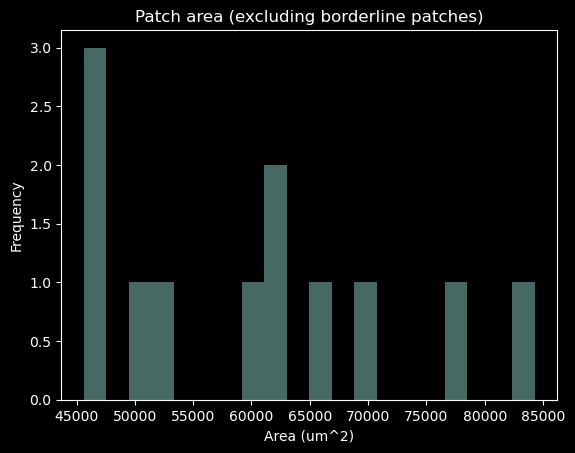

In [59]:
non_border_roi_areas = get_non_border_roi_areas(rois_auto, resolution, x_axis, y_axis)
plot_roi_areas_borders_out(non_border_roi_areas)

try:
    if len(non_border_roi_areas)>0:   
        mean_non_border_roi_areas=int(np.mean(non_border_roi_areas))

    else:
        print('Sorry, no patterns that do not touch the borders!')
        mean_non_border_roi_areas='Nan'
        
except Exception as e:
    print(f'An error occurred: {e}')

In [60]:
print(f'The maximal size (of the whole FOV) is {x_axis*y_axis*(resolution**2)} um**2 ')

The maximal size (of the whole FOV) is 1272383.9999999998 um**2 


In [61]:
rois_auto = filtered_rois_auto
len(rois_auto)

14

## compute centroids (of filtered rois)

In [62]:
def compute_centroids(rois_auto, tiff_shape, save_dir=None):
    rois_auto_centroids = []
    for roi in rois_auto:
        centroid = np.array(center_of_mass(roi))
        rois_auto_centroids.append(centroid)

    return rois_auto_centroids 

In [63]:
rois_auto_centroids = compute_centroids(rois_auto, movie_shape, save_dir=save_dir_NMF)

In [64]:
len(rois_auto_centroids)

14

## plot them

In [65]:
len(filtered_rois_auto)

14

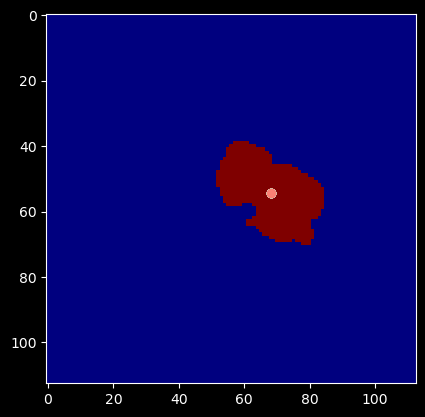

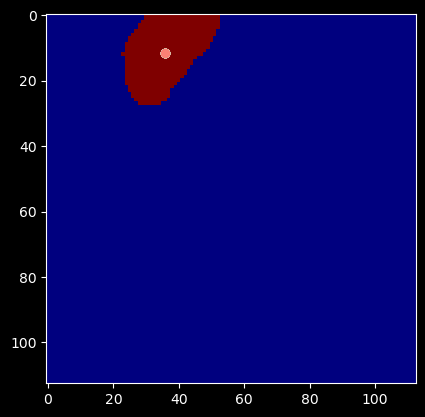

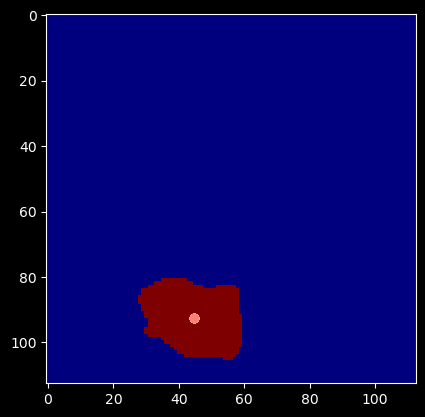

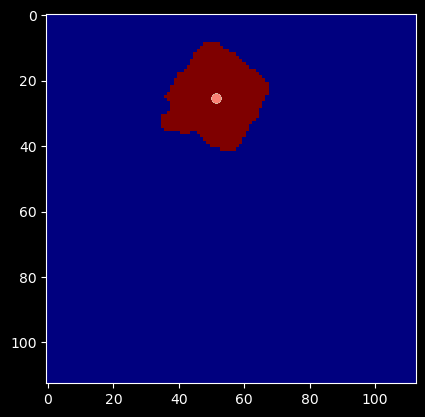

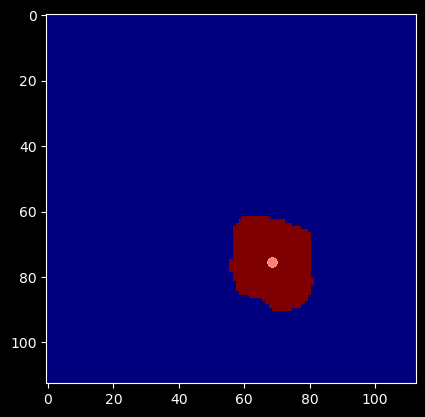

...

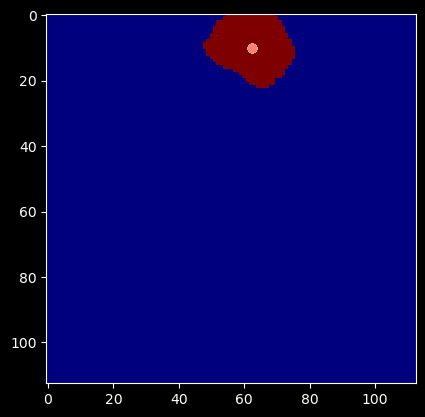

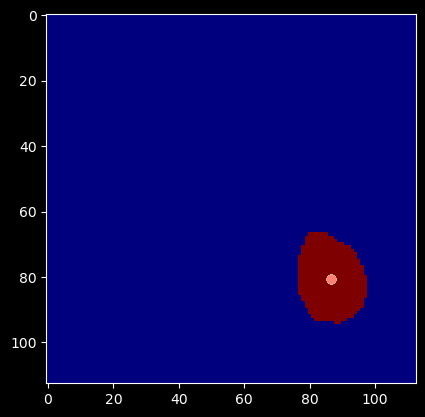

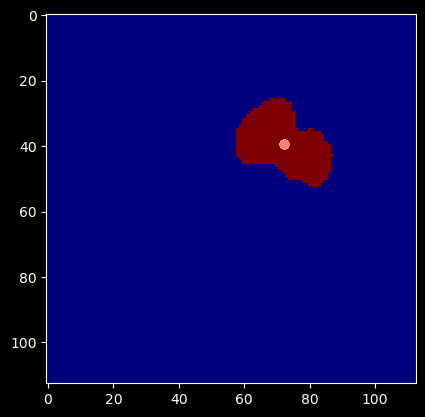

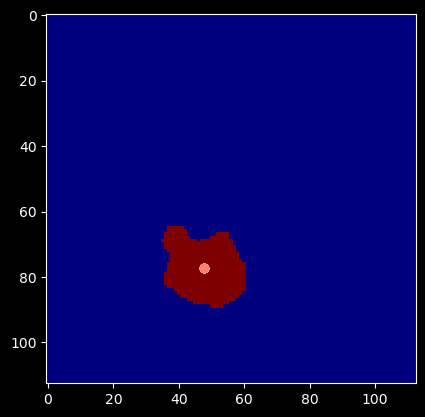

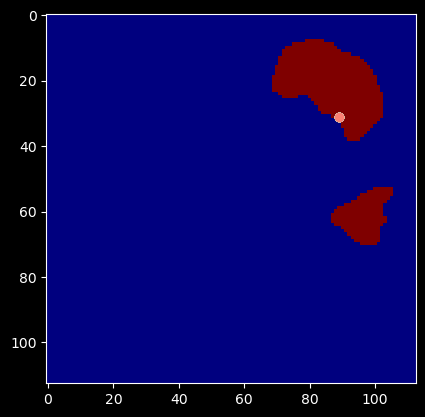

In [66]:
plot_rois_auto_centroids(filtered_rois_auto, rois_auto_centroids, save_dir=save_dir_NMF)

In [67]:
x_axis = int(x_axis)
y_axis = int(y_axis)

In [68]:
centroid_pixel_indices = get_pixel_indices_for_centroids(rois_auto_centroids, x_axis_FOV= x_axis)

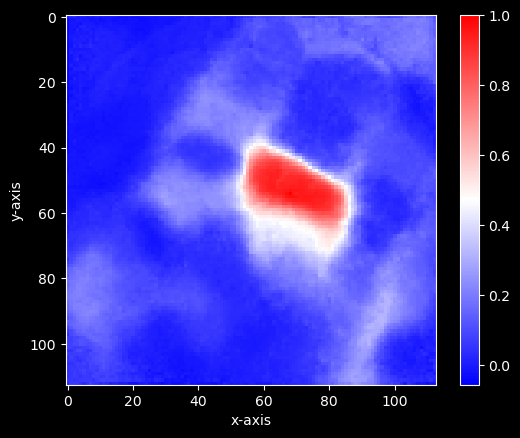

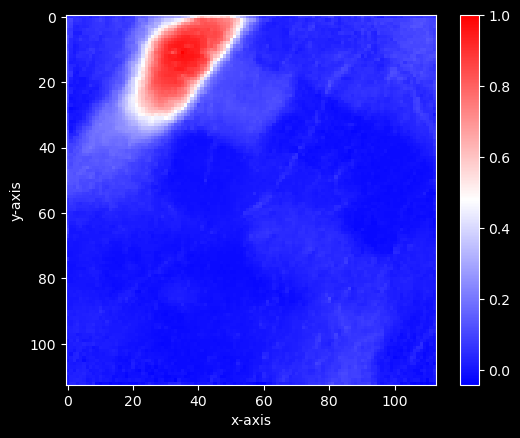

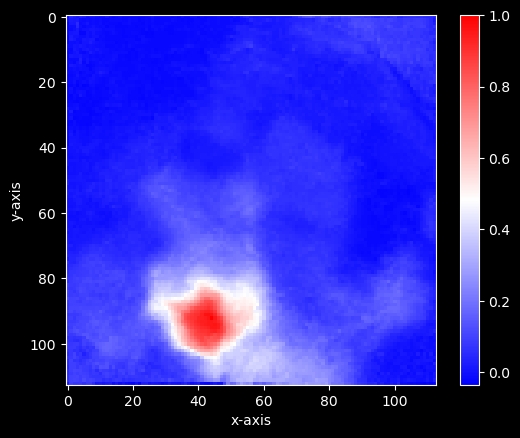

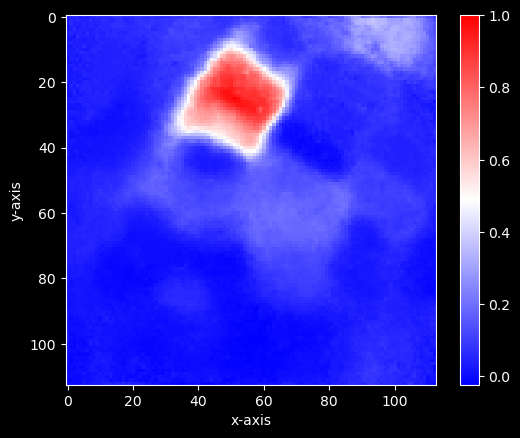

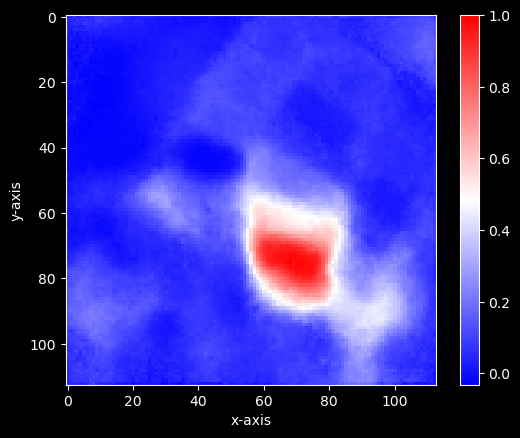

...

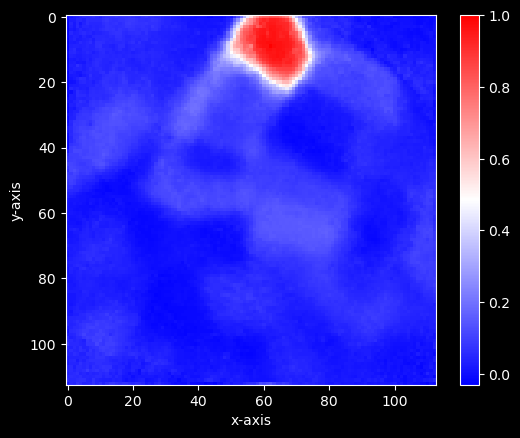

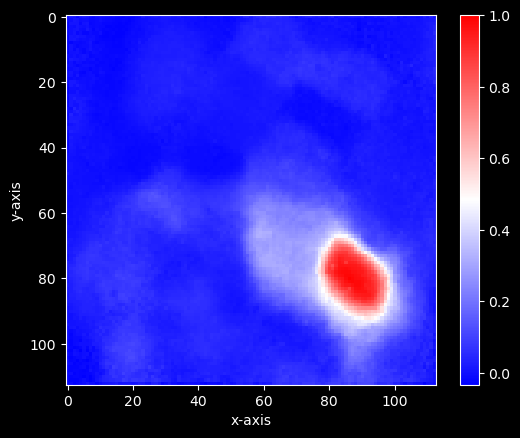

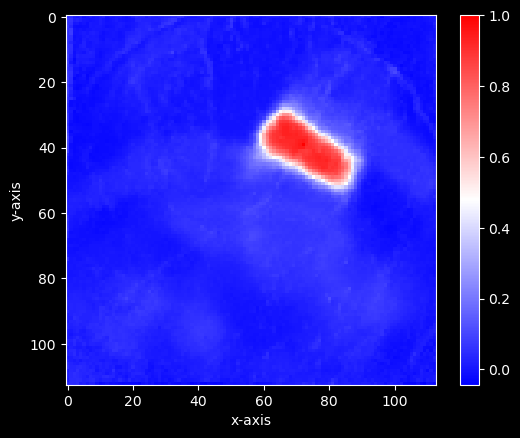

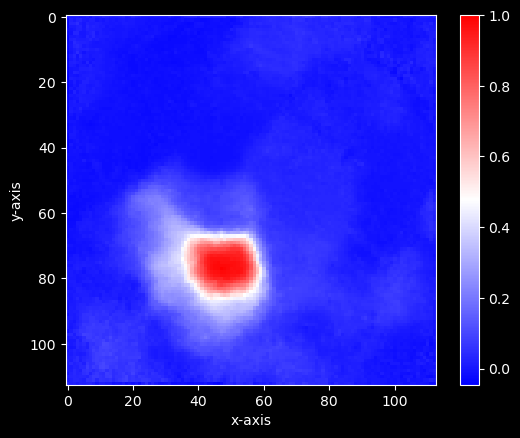

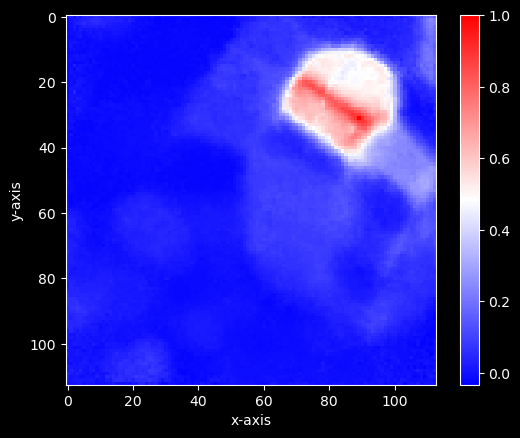

In [69]:
seed_corrs = [] #out, to not empty every time we loop

for i, centroid in enumerate(centroid_pixel_indices):

    seed_corr = np.corrcoef(data.T)[centroid, :]
    seed_corrs.append(seed_corr) #actually its already stored in intial roi to roi pixel corr
    plt.imshow(seed_corr.reshape((x_axis, y_axis)), cmap='bwr')
    plt.colorbar()
    plt.xlabel('x-axis')
    plt.ylabel('y-axis')
    plt.show()

In [70]:
len(rois_auto_centroids)

14

In [71]:
filtered_rois_idxs

[0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]

In [72]:
len(rois_auto)

14

## Seed correlations to assess stability of patterns 

## TO DO.Fix mmismatch between the rois auto an fiiltered rois auto

C:\Users\zaggila\AppData\Local\Temp\ipykernel_17820\2188743407.py:24: UserWarning: The following kwargs were not used by contour: 'fill'
  axs[i,1].contour(rois_auto[i][:,:], linewidths=2, fill=False) #plotting outline of nmf output
C:\Users\zaggila\AppData\Local\Temp\ipykernel_17820\2188743407.py:32: UserWarning: The following kwargs were not used by contour: 'fill'
  axs[i,1].contour(rois_auto[i][:,:], linewidths=2, fill=False) #plotting outline of nmf output
C:\Users\zaggila\AppData\Local\Temp\ipykernel_17820\2188743407.py:48: UserWarning: The following kwargs were not used by contour: 'fill'
  axs[i,j+2].contour(rois_auto[i][:,:], linewidths=2, fill=False) #plotting outline of nmf output


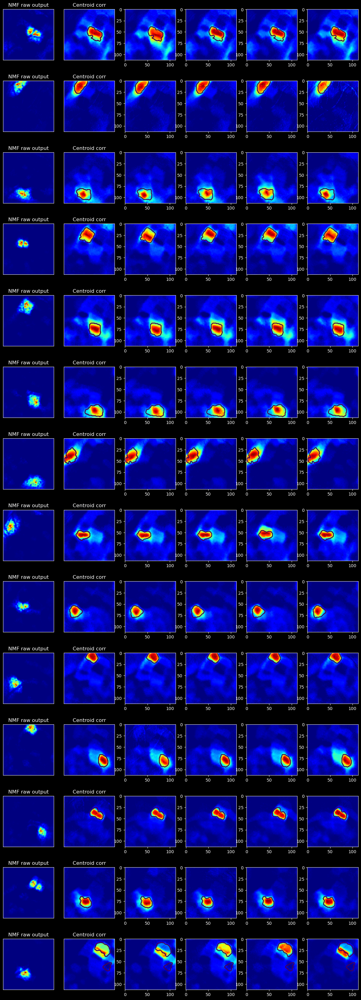

In [73]:
  # Create a subplot grid with 1 row and 5 columns
corr_matrix = np.corrcoef(data.T)
corr_matrix.shape


steps = [(3, 0), (0,3), (-3,0), (0,-3)]

plt.style.use('dark_background')
fig, axs = plt.subplots(len(rois_auto), len(steps) + 2, figsize=(15, 3 * len(rois_auto)))

for i, pixel_index in enumerate(centroid_pixel_indices):
    seed_corr = corr_matrix[pixel_index, :] #rois x rois 
    seed_corrs.append(seed_corr) # len(rois_auto))

    centroid_x = rois_auto_centroids[i][0] # x and y coords of each patch centroid 
    centroid_y = rois_auto_centroids[i][1]

        # Plot the original correlation
    axs[i, 0].imshow(loading_imgs[i], cmap='jet')
    axs[i, 0].set_title('NMF raw output')
    axs[i, 0].set_xticks([])
    axs[i, 0].set_yticks([])

    axs[i,1].contour(rois_auto[i][:,:], linewidths=2, fill=False) #plotting outline of nmf output 

    # Plot the original correlation
    axs[i, 1].imshow(seed_corr.reshape((x_axis, y_axis)), cmap='jet', vmin=0, vmax=1)
    axs[i, 1].set_title('Centroid corr')
    axs[i, 1].set_xticks([])
    axs[i, 1].set_yticks([])

    axs[i,1].contour(rois_auto[i][:,:], linewidths=2, fill=False) #plotting outline of nmf output 
    
    step_seeds = []


    for step_index, (step_x, step_y) in enumerate(steps):

#        for j in rois_auto_centroids:
        step_seed = (int(centroid_x) + step_x, int(centroid_y) + step_y)
        step_seeds.append(step_seed)

    for j, new_centroids in enumerate(step_seeds):
            
        new_centroids_index = get_pixel_indices_for_centroids([new_centroids], x_axis_FOV=x_axis)
        step_seed_corr = corr_matrix[new_centroids_index, :]
        axs[i,j+2].imshow(step_seed_corr.reshape((x_axis, y_axis)), cmap='jet', vmin=0, vmax=1)
        axs[i,j+2].contour(rois_auto[i][:,:], linewidths=2, fill=False) #plotting outline of nmf output 

fig.savefig(save_dir_NMF + '/seed_corrs_step_3.png', bbox_inches="tight")

plt.show()

## plot patterns & contours in space

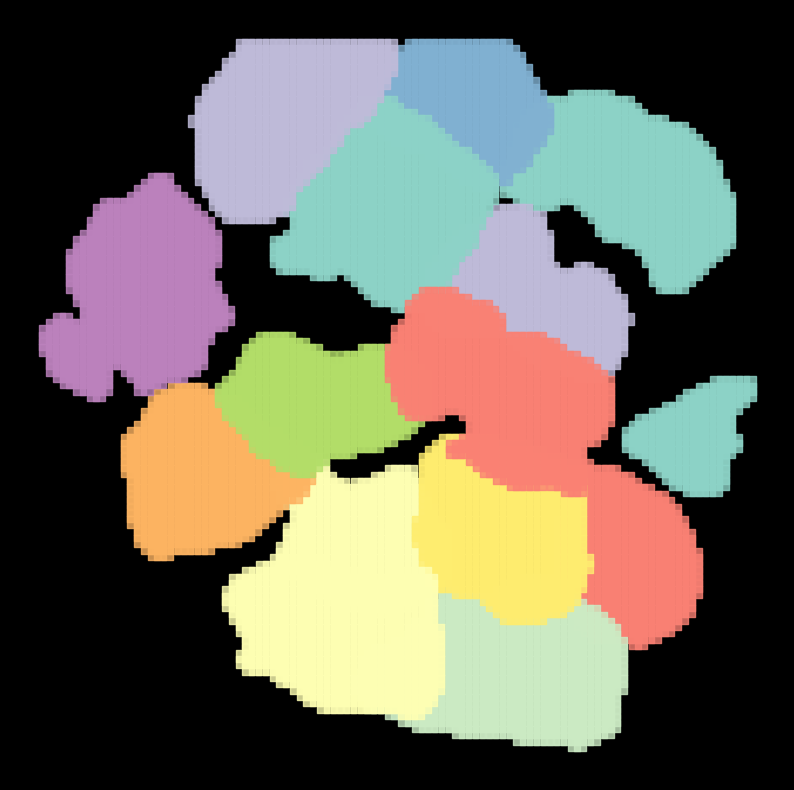

In [74]:
plot_rois_scatters(rois_auto, movie_shape, save_dir=save_dir_NMF)

In [75]:
def plot_rois_contours(rois_auto, tiff_shape, save_dir=None):
    plt.figure(figsize=(10, 10))
    
    for i, roi in enumerate(rois_auto):  
        # Create contour plot (without invalid 'fill' argument)
        contours = plt.contour(roi[::-1, :], colors=f'C{i}', linewidths=1.2)
        
        # Ensure contours exist before iterating
        if hasattr(contours, "collections"):
            for contour in contours.collections:  
                contour.set_edgecolor(f'C{i}')
                contour.set_facecolor("none")  # Prevents unwanted fills

    plt.title("ROI Contours")
    plt.show()

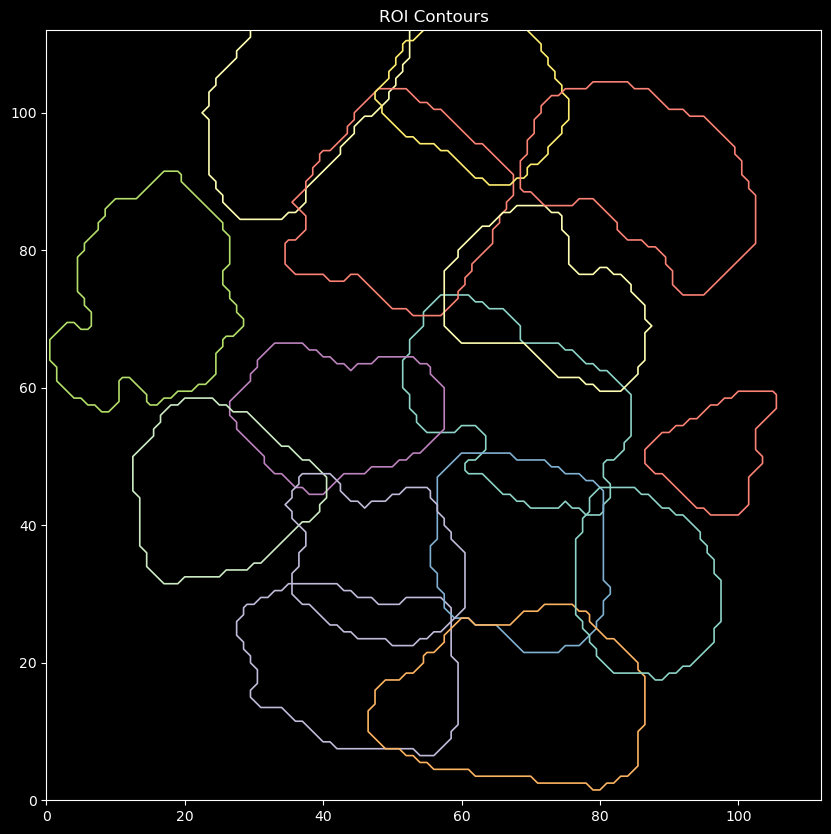

In [76]:
plot_rois_contours(rois_auto, movie_shape, save_dir=save_dir_NMF)

In [77]:
conts, n_conts = get_roi_conts(rois_auto)

Saving rois_conts_largest.png ...


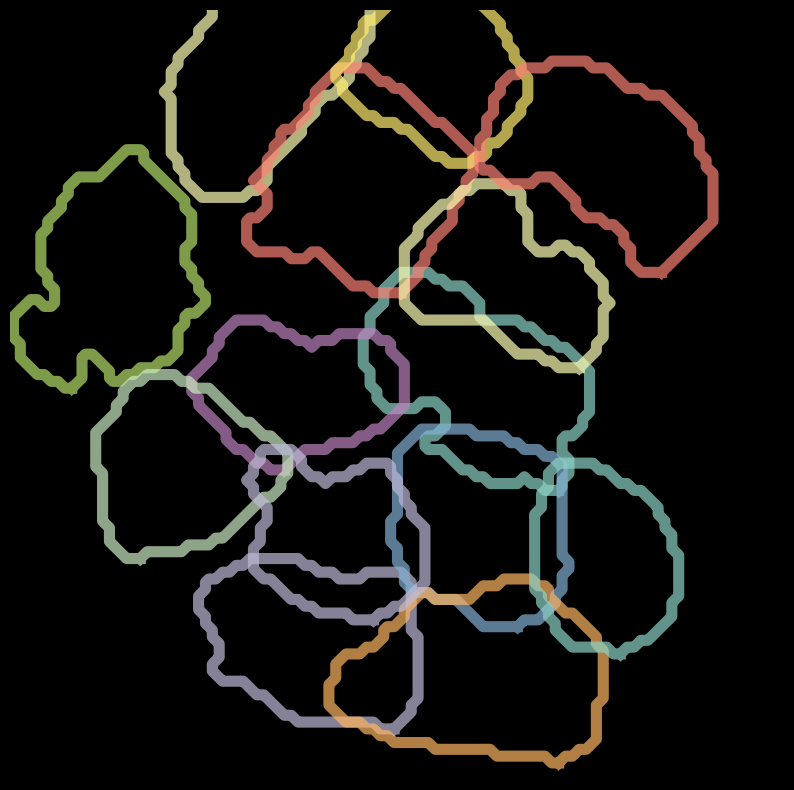

In [78]:
plot_roi_conts_largest(conts[:], movie_shape, save_dir=save_dir_NMF)

# Compute pattern overlaps (iou)

1. checking two nmf rois
2. compute for all
3. add adjacency info
4. add correlation as function of distance between pixels (patches?)



6. *** just do patch corr as function of centroid distance ***
7. *** add corr of pixels within vs corr within-without 

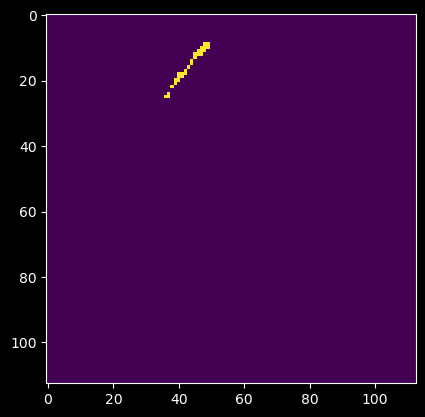

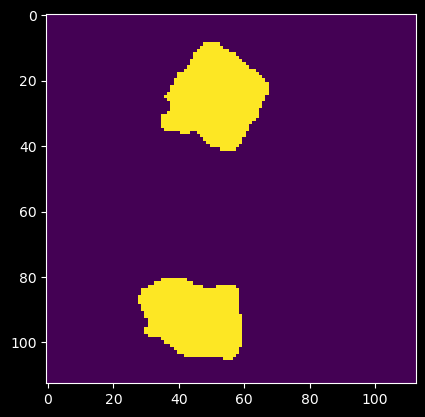

In [79]:
plt.imshow(np.logical_and(rois_auto[1], rois_auto[3]))
plt.show()

plt.imshow(np.logical_or(rois_auto[2], rois_auto[3]))
plt.show()

# replace the rois_auto with their filtered version (to exclude then the too big ones from centroid, iou, frequency): rois_auto = filtered_rois_auto 

In [80]:
rois_auto = filtered_rois_auto

In [81]:
# should be 0 if no overlap
np.sum(np.logical_or(rois_auto[2], rois_auto[3]))
np.sum(np.logical_and(rois_auto[2], rois_auto[0]))

0

## Compute iou matrix

In [82]:
ious, mean_iou = compute_iou(rois_auto)

In [83]:
# ious

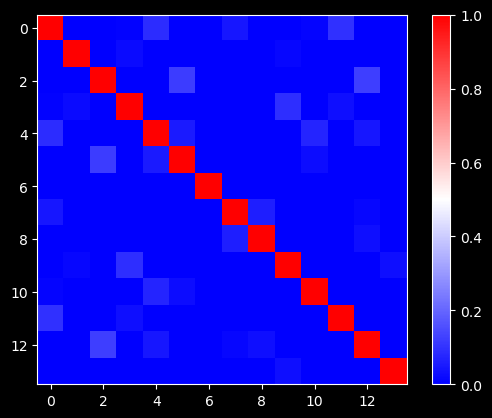

In [84]:
ious_mat = compute_iou_matrix(rois_auto)

plt.imshow(ious_mat, vmin=0, vmax=1, cmap='bwr')
fig.savefig(save_dir_NMF + '/ious.png', bbox_inches="tight")
plt.colorbar()

## Threshold & get rid of 0s in ious
so that the overlap becomes more representative (only calculate if non zero xhich probably signifies far away patterns)

In [85]:
ious_filt = [i for i in ious if i !=0]


In [86]:
ious_filt_mean = np.mean(ious_filt)

## Compute W matrix corr

confused: what do i compute here ? corr of raw ? 

def filter_w_mat(W, filtered_rois_idxs):
    filtered_w = W[filtered_rois_idxs, :]

    return filtered_w

In [87]:
def filter_w_mat(W, filtered_rois_idxs):
    filtered_w = W[filtered_rois_idxs, :]

    return filtered_w

In [88]:
W.shape
W[0] #pixel weights 
W[2]

array([0.00000000e+00, 1.38062709e-03, 1.23297431e-03, ...,
       1.08770513e-04, 7.05425130e-05, 3.51756369e-04])

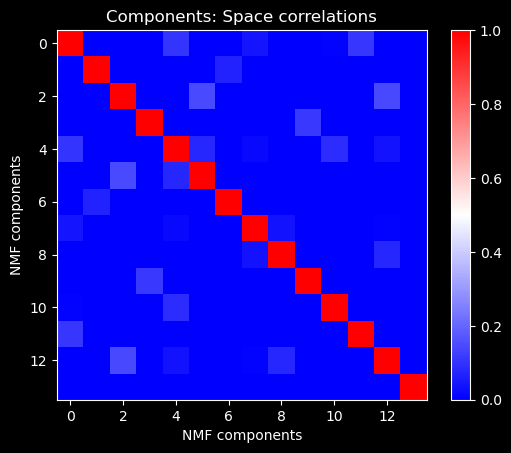

In [89]:
filtered_w = filter_w_mat(W, filtered_rois_idxs)
nmf_space_corr = np.corrcoef(filtered_w)
           
plot_nmf_space_corr(nmf_space_corr, save_dir=save_dir_NMF)

## Plot together W matrix corr and IoU 

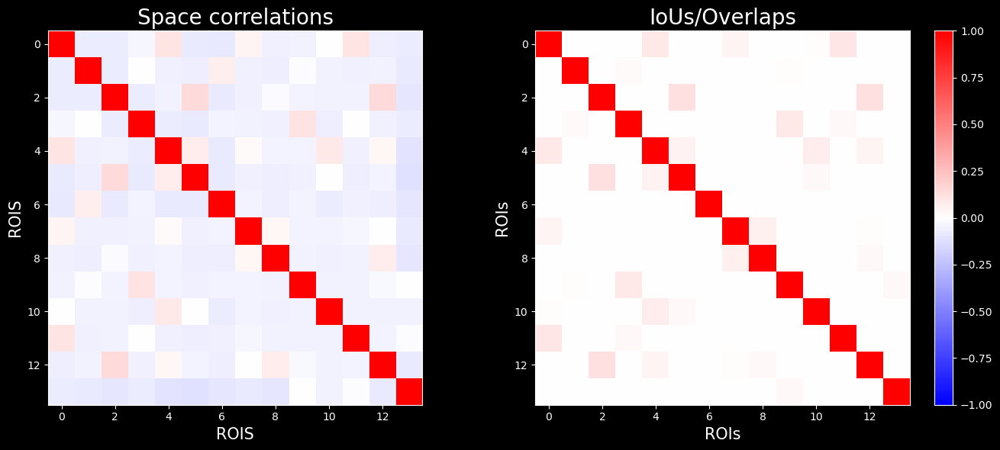

In [90]:
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Plot the NMF components correlation matrix
im = axs[0].imshow(nmf_space_corr, vmin=-1, vmax=1, cmap='bwr')
axs[0].set_xlabel('ROIS', fontsize=15)
axs[0].set_ylabel('ROIS', fontsize=15)
axs[0].set_title('Space correlations', fontsize=20)

# Plot the IoU matrix
im = axs[1].imshow(ious_mat, vmin=-1, vmax=1, cmap='bwr')
axs[1].set_xlabel('ROIs', fontsize=15)
axs[1].set_ylabel('ROIs', fontsize=15)
axs[1].set_title('IoUs/Overlaps', fontsize=20)

plt.colorbar(im, ax=axs[1])
plt.tight_layout()

fig.savefig(save_dir_NMF + '/corr_mat_space_ious.png', bbox_inches="tight")

plt.show()

C:\Users\zaggila\AppData\Local\Temp\ipykernel_17820\536985668.py:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


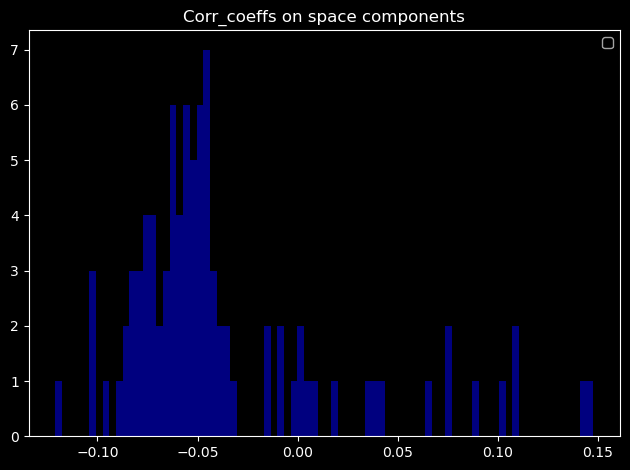

In [91]:
up_triangle_W_inds = np.triu(nmf_space_corr, k=1) #k=1 means exclude diagonal (in this case zero it along the lower traingle)
up_triangle_W_coeffs = nmf_space_corr[up_triangle_W_inds !=0] #keep whats not 0, so exclude lower traingle and diagonal

plt.hist(up_triangle_W_coeffs, bins=80, color='b', alpha=0.5)
plt.legend()
plt.title('Corr_coeffs on space components')
plt.tight_layout()
plt.show()

## exclude bad comps becs corr is zero, or neg and that will give faulty calcs

In [92]:
H.shape

(5400, 15)

# Filter out H temporal traces (to match filtered masks)

In [93]:
def filter_h_mat(H, filtered_rois_idxs):
    filtered_h = H.T[filtered_rois_idxs, :] #n_components, time 
    return filtered_h

In [94]:
filtered_h = filter_h_mat(H, filtered_rois_idxs)

In [95]:
filtered_h.shape

(14, 5400)

In [96]:
nmf_temp_corr = np.corrcoef(filtered_h)

In [97]:
nmf_temp_corr.shape

(14, 14)

## Compute centroid distances and plot corr of patches as their function ( the ones kept from size thresholding)

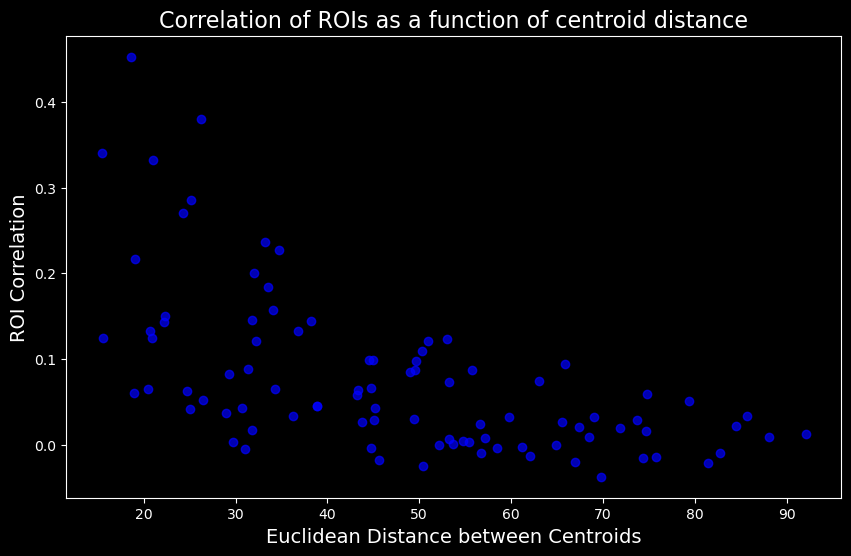

In [98]:
centroid_distances = pdist(rois_auto_centroids, metric='euclidean')
distance_matrix = squareform(centroid_distances)  # convert to square form for better visualization

flattened_distances = centroid_distances
flattened_correlations = nmf_temp_corr[np.triu_indices(len(rois_auto_centroids), k=1)]  # Upper triangle, no diagonal

plt.figure(figsize=(10, 6))
plt.scatter(flattened_distances, flattened_correlations, color='blue', alpha=0.7)
plt.title("Correlation of ROIs as a function of centroid distance", fontsize=16)
plt.xlabel("Euclidean Distance between Centroids", fontsize=14)
plt.ylabel("ROI Correlation", fontsize=14)
plt.show()

### temporal features (of filtered out rois_auto and their corresponding temp traces)

In [99]:
filtered_h.shape

(14, 5400)

In [100]:
filtered_h.shape

(14, 5400)

In [101]:
H.shape

(5400, 15)

In [102]:
# reshaped_tiff = data.reshape(data.shape[0], x_axis, y_axis)
# print(reshaped_tiff.shape)

# rois_acts_all = []
# roi_acts_sums =[]

# for i, roi in enumerate(rois_auto):
   
#     mutliplied_tiff_auto_roi = rois_auto[i] * reshaped_tiff #this sets to 0 everything F and only gives info of T pixels within that assembly-nmf
#     sum_of_roi_activity = mutliplied_tiff_auto_roi.sum(axis=(1,2))
    
    
#     fig, axs = plt.subplots(2* len(rois_auto), 1, figsize=(15, 5 * len(rois_auto)))

#     axs[0,i].plot(stats.zscore(sum_of_roi_activity))
#     axs[0,i].plot(stats.zscore(filtered_h.T[:, i])) #filtered_h has shape like w, (n_components, time)
#     axs[0,i].set_title(f'Sum of pixels value across time for pattern - temporal trace of pattern {i+1} ')
    
#     corr_coeff = np.corrcoef(sum_of_roi_activity, filtered_h.T[:, i])[0,1] #.T becs filtered_h shape (n_components, time)
#     axs[0,i].legend(title = f'pairwise corr is {corr_coeff:.2f}')
    
#     mutliplied_tiff_auto_roi_flat = mutliplied_tiff_auto_roi.reshape(mutliplied_tiff_auto_roi.shape[0], mutliplied_tiff_auto_roi.shape[1] * mutliplied_tiff_auto_roi.shape[2])
    
#     # axs[1].imshow(sort_by_pc1(mutliplied_tiff_auto_roi_flat, component=0).T, aspect='auto', cmap='hot')
#     axs[1,i].imshow(mutliplied_tiff_auto_roi_flat.T, aspect='auto', cmap='hot')

#     axs[1,i].set_xlabel('time (frames)')
#     axs[1,i].set_ylabel('rois')
#     axs[1,i].set_title(f'rasterplot with all rois (only pixels belonging to pattern {i+1})')    

# roi_acts_sums.append(sum_of_roi_activity)
# rois_acts_all.append(roi_acts_sums)

# fig.savefig(save_dir_NMF + f'time_component_with_summed_acts.png', bbox_inches="tight")

# plt.tight_layout()

# plt.show()

In [103]:
n_rois = len(rois_auto)
n_rois

14

14it [00:06,  2.11it/s]


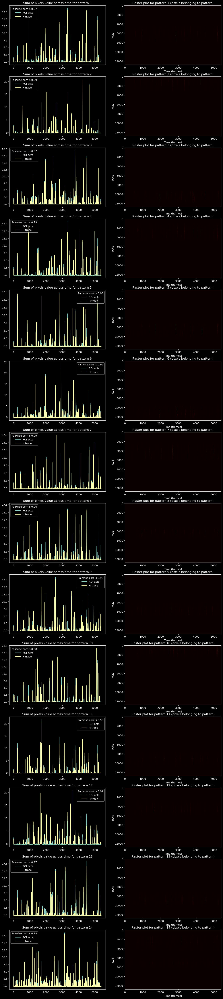

In [104]:
# Number of ROIs and corresponding subplots
from tqdm import tqdm 

x_axis = int(x_axis)
y_axis = int(y_axis)

reshaped_tiff = data.reshape(data.shape[0], x_axis, y_axis)
fig, axs = plt.subplots(len(rois_auto), 2, figsize=(15, 5 * len(rois_auto)))  # 2 subplots per ROI (one temporal, one raster)

# Lists to collect data
rois_acts_all = []
roi_acts_sums = []

# Loop over each ROI and create 2 subplots for each
for i, roi in tqdm(enumerate(rois_auto)):
    
    # Apply the ROI mask to the TIFF data
    mutliplied_tiff_auto_roi = rois_auto[i] * reshaped_tiff  # Set F to 0, only keep T pixels
    sum_of_roi_activity = mutliplied_tiff_auto_roi.sum(axis=(1, 2))  # Sum activity over spatial dimensions
    
    # Plot the temporal trace
    axs[i,0].plot(stats.zscore(sum_of_roi_activity), label='ROI acts')
    axs[i,0].plot(stats.zscore(filtered_h.T[:, i]), label='H trace')  # Filtered temporal component
    axs[i,0].set_title(f'Sum of pixels value across time for pattern {i+1}')
    
    # Compute correlation coefficient
    corr_coeff = np.corrcoef(sum_of_roi_activity, filtered_h.T[:, i])[0, 1]
    axs[i,0].legend(title=f'Pairwise corr is {corr_coeff:.2f}')
    
    # Flatten the ROI data and plot the raster plot
    mutliplied_tiff_auto_roi_flat = mutliplied_tiff_auto_roi.reshape(
        mutliplied_tiff_auto_roi.shape[0], 
        mutliplied_tiff_auto_roi.shape[1] * mutliplied_tiff_auto_roi.shape[2]
    )
    
    # Plot the raster plot
    axs[i,1].imshow(mutliplied_tiff_auto_roi_flat.T, aspect='auto', cmap='hot')
    axs[i,1].set_xlabel('Time (frames)')
    axs[i,1].set_ylabel('ROIs')
    axs[i,1].set_title(f'Raster plot for pattern {i+1} (pixels belonging to pattern)')
    
    # Append the summed activity to the list
    roi_acts_sums.append(sum_of_roi_activity)

# Append the activity sums of all ROIs to the main list
rois_acts_all.append(roi_acts_sums)

# Save the entire figure (outside the loop to avoid overwriting)
fig.savefig(save_dir_NMF + f'time_component_summed_acts_all_rois.png', bbox_inches="tight")

# Show the figure with all subplots
plt.show()

In [105]:
H.shape

(5400, 15)

In [106]:
def plot_roi_loading_time(rois_auto, H, title='space & time comps', save_dir=None):
    
    n_components = len(rois_auto) 

    fig, axs = plt.subplots(len(rois_auto), 2, figsize=(5, len(rois_auto)), width_ratios=[1, 4], dpi=200)
    plt.suptitle(title, fontsize=10)

    for (i, H) in enumerate(H):
        axs[i,0].imshow(rois_auto[i], cmap='plasma') #was gray 
        axs[i,0].xaxis.set_ticklabels('') 
        axs[i,0].yaxis.set_ticklabels('') 
        axs[i,0].xaxis.set_ticks([]) 
        axs[i,0].yaxis.set_ticks([]) 

        axs[i,1].plot(H.T[:2000], c='b') #was gray
        axs[i,1].axis('off')

        if i == 0:
            axs[i,0].set_title('spatial component', fontsize=7)
            axs[i,1].set_title('temporal component', fontsize=7)
    plt.savefig(save_dir + ('space_and_time_comps.png'))
    plt.show()

## Get summed pixel acts (like h var) of filtered 'good' rois and compute corr_coeff

In [107]:
len(rois_acts_all) #gather all summed pixel traces within patch
rois_acts_all = np.array(rois_acts_all)

In [108]:
rois_acts_all.shape

(1, 14, 5400)

In [109]:
rois_acts_all = np.squeeze(rois_acts_all)  # This removes all singleton dimensions
rois_acts_all.shape

(14, 5400)

In [110]:
time_patch_sum_corr = np.corrcoef(rois_acts_all)

In [111]:
time_patch_sum_corr.shape

(14, 14)

# Plot pattern correlation H) - centroid distance 

In [112]:
#Compute centroid distances 
centroid_distances = pdist(rois_auto_centroids, metric='euclidean')
distance_matrix = squareform(centroid_distances)  # convert to square form for better visualization

#extract correlations from corr mat
flat_centroid_dists = centroid_distances
flattened_correlations_sumpix = time_patch_sum_corr[np.triu_indices(len(rois_auto_centroids), k=1)]  # Upper triangle, no diagonal

flat_centroid_dists_um = (flat_centroid_dists * 10)

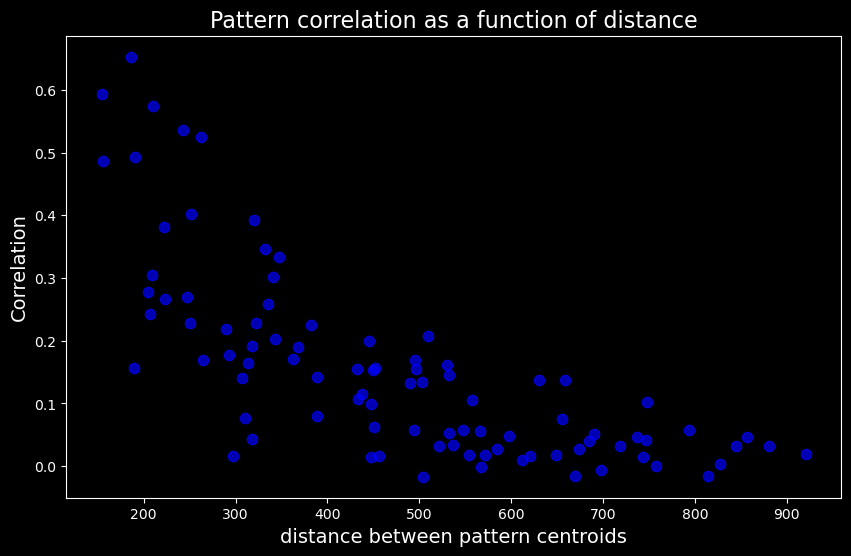

In [113]:
plt.figure(figsize=(10, 6))
plt.scatter(flat_centroid_dists_um, flattened_correlations_sumpix, color='blue', s=55, alpha=0.7)
plt.title("Pattern correlation as a function of distance", fontsize=16)
plt.xlabel("distance between pattern centroids", fontsize=14)
plt.ylabel("Correlation", fontsize=14)
plt.savefig(save_dir_NMF + 'pattern_corr_centroid_dist.png', bbox_inches="tight")
plt.show()

## Fit line 

In [114]:
flat_centroid_dists_um = (flat_centroid_dists * 10)
flat_centroid_dists_um.astype(int)

array([536, 446, 335, 210, 432, 554, 262, 451, 449, 319, 155, 306, 313,
       814, 207, 718, 921, 346, 446, 567, 264, 856, 456, 669, 566, 674,
       293, 243, 611, 367, 322, 844, 433, 597, 154, 757, 529, 742, 389,
       318, 494, 190, 654, 250, 520, 382, 221, 648, 331, 445, 659, 185,
       362, 209, 489, 793, 495, 532, 880, 247, 584, 290, 697, 317, 297,
       557, 827, 571, 504, 746, 204, 502, 509, 343, 223, 532, 684, 630,
       547, 251, 736, 747, 310, 690, 341, 437, 388, 496, 451, 189, 620])

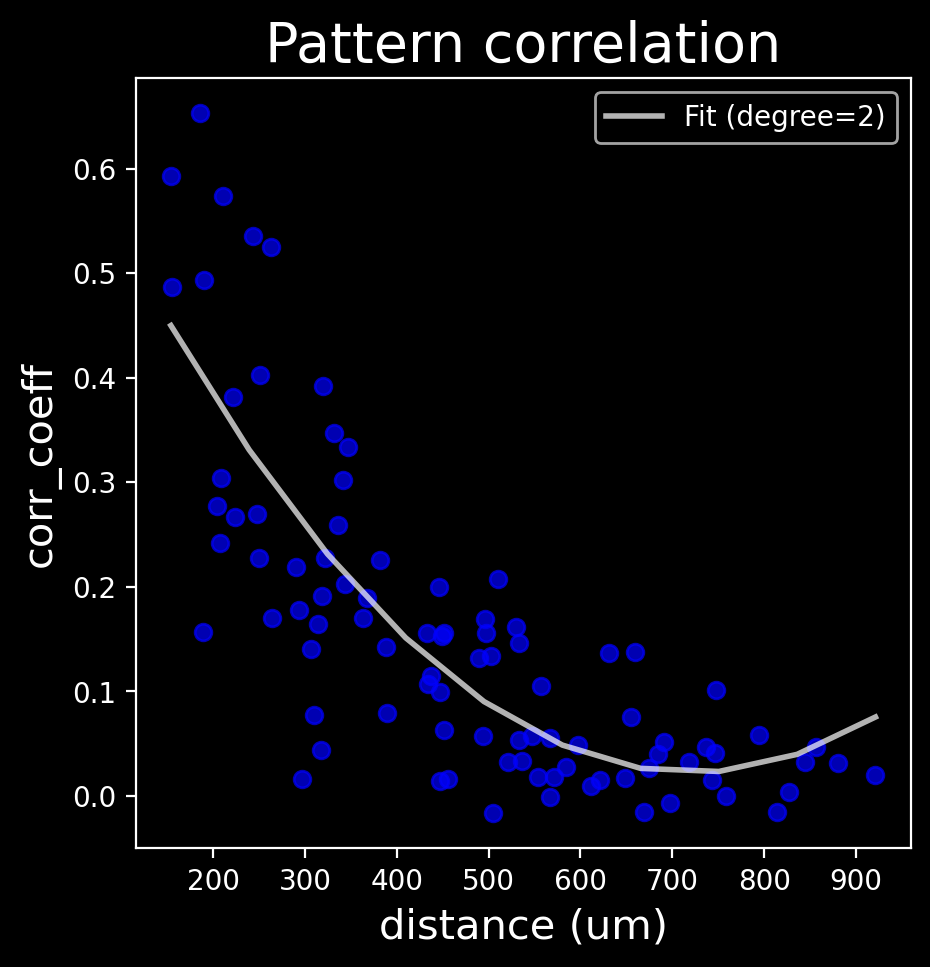

In [115]:
plt.figure(figsize = (5, 5), dpi = 200)
plt.scatter(flat_centroid_dists_um, flattened_correlations_sumpix, color='blue', alpha=0.7)

# Fit a polynomial of degree 2 (quadratic) or higher (cubic, etc.)
degree = 2  # Change this to 3 for cubic, 4 for quartic, etc.
poly_fit_corr_coeffs = np.polyfit(flat_centroid_dists_um, flattened_correlations_sumpix, degree)

# Generate x values for the fitted curve
poly_fit_x_vals_corr = np.linspace(min(flat_centroid_dists_um), max(flat_centroid_dists_um), 10)                               
                                                                                                                                           
# Generate y values using the polynomial coefficients
poly_fit_y_vals_corr = np.polyval(poly_fit_corr_coeffs, poly_fit_x_vals_corr)

# Plot the polynomial fit
plt.plot(poly_fit_x_vals_corr, poly_fit_y_vals_corr, color='white', label=f'Fit (degree={degree})', linewidth=2, alpha=0.7)

# Add title and labels
plt.title("Pattern correlation", fontsize=20)
plt.xlabel("distance (um)", fontsize=15)
plt.ylabel("corr_coeff", fontsize=15)
plt.savefig(save_dir_NMF + 'correlation_distance_polyfit.png')

# Add legend
plt.legend()
plt.show()

## adapt tofucntion for ious, but due to annoying xy issue and no time use this for now (see compute: get_dist_binned_corr)

In [116]:
bins_corr, bin_means_corr, bin_stds_corr, bin_cents_corr = compute_dist_bin_corr(flat_centroid_dists, flattened_correlations_sumpix, bin_size=100)

bins[   0.  100.  200.  300.  400.  500.  600.  700.  800.  900. 1000.]


In [117]:
compute_dist_bin_corr?

Signature: compute_dist_bin_corr(distances, correlations, bin_size=10)
Docstring: <no docstring>
File:      c:\users\zaggila\documents\pixelnmf\patchnmf\analyse\compute.py
Type:      function

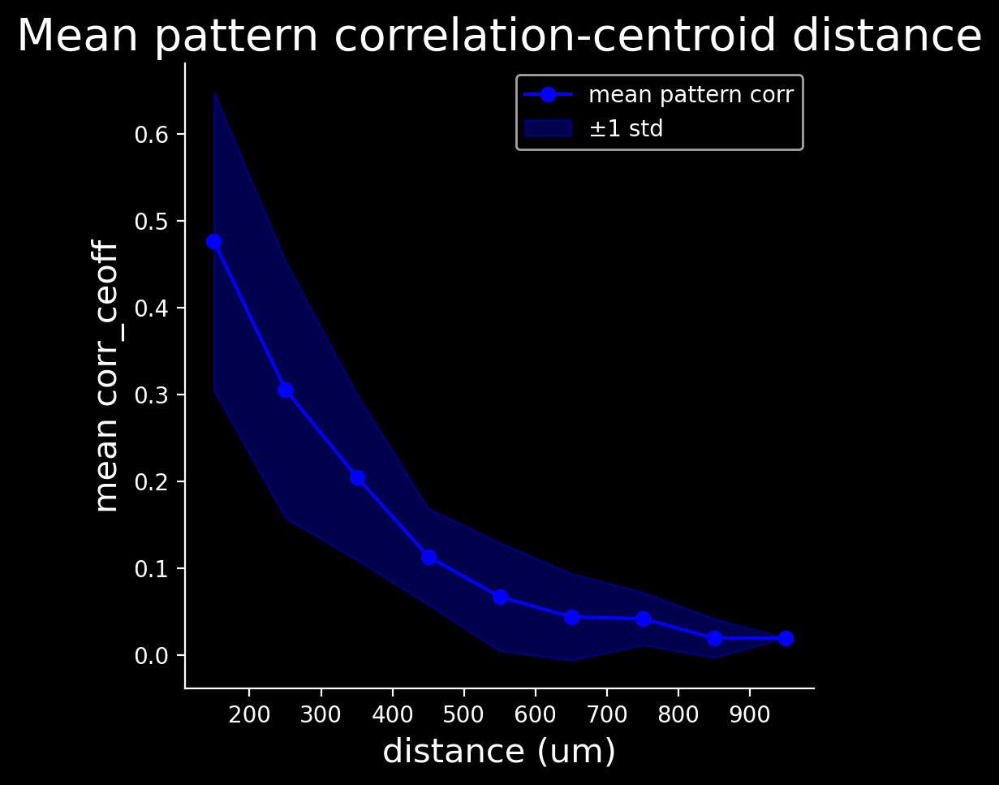

In [118]:
plot_bin_dist_corr(bin_means_corr, bin_stds_corr, bin_cents_corr, save_dir=save_dir_NMF)

In [119]:
# means_h_corr, stds_h_corr, bins_h_corr = get_dist_binned_corr(flat_centroid_dists, flattened_correlations_sumpix, dist_binning=10)

In [120]:
# def plot_dist_bin_h_corrs(bins_h_corr, means_h_corr, stds_h_corr, save_dir=None):

#     bin_cents_h_corr = (bins_h_corr[:-1] + bins_h_corr[1:]) / 2  # Midpoints of bins
#     print(len(bin_cents_h_corr))
    
#     # Create the plot
#     plt.figure(figsize=(10, 6))
#     plt.errorbar(bin_cents_h_corr, means_h_corr, yerr=stds_h_corr, fmt='o-', color='blue', 
#                  label='Mean corr with ±1 STD', markersize=5, capsize=5)
    
#     plt.title("Pattern correlation - centroid istance", fontsize=16)
#     plt.xlabel("distance between pattern centroids", fontsize=14)
#     plt.ylabel("Mean pattern correlation", fontsize=14)
#     plt.xticks(bins_h_corr)  # Optional: Adjust x-ticks for better visibility
#     plt.ylim(0, 1)  # Assuming IoU values range from 0 to 1
#     plt.legend()
#     ax= plt.gca()
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
#     plt.savefig(save_dir + 'pattern_correl_centroid_dist.png', bbox_inches="tight")

    
#     plt.show()
    
#     return bin_cents_h_corr

In [121]:
# bin_cents_h_corr = plot_dist_bin_h_corrs(bins_h_corr, means_h_corr, stds_h_corr, save_dir=save_dir_NMF)

# IoUs as function of centroid distance (suppl. fig for IoU plot)

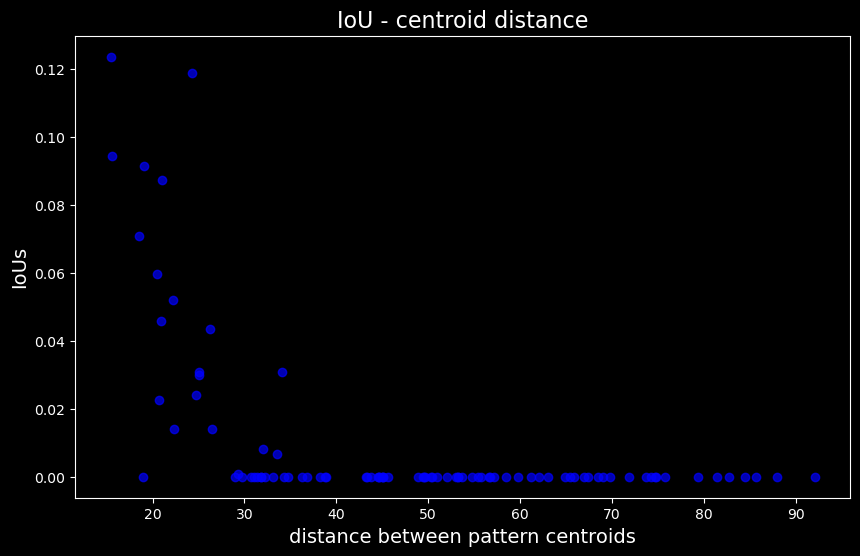

In [122]:
plt.figure(figsize=(10, 6))
plt.scatter(flat_centroid_dists, ious, color='blue', alpha=0.7)
plt.title("IoU - centroid distance", fontsize=16)
plt.xlabel("distance between pattern centroids", fontsize=14)
plt.ylabel("IoUs", fontsize=14)
plt.savefig(save_dir_NMF + 'pattern_iou_centroid_dist.png', bbox_inches="tight")
plt.show()

## fit 

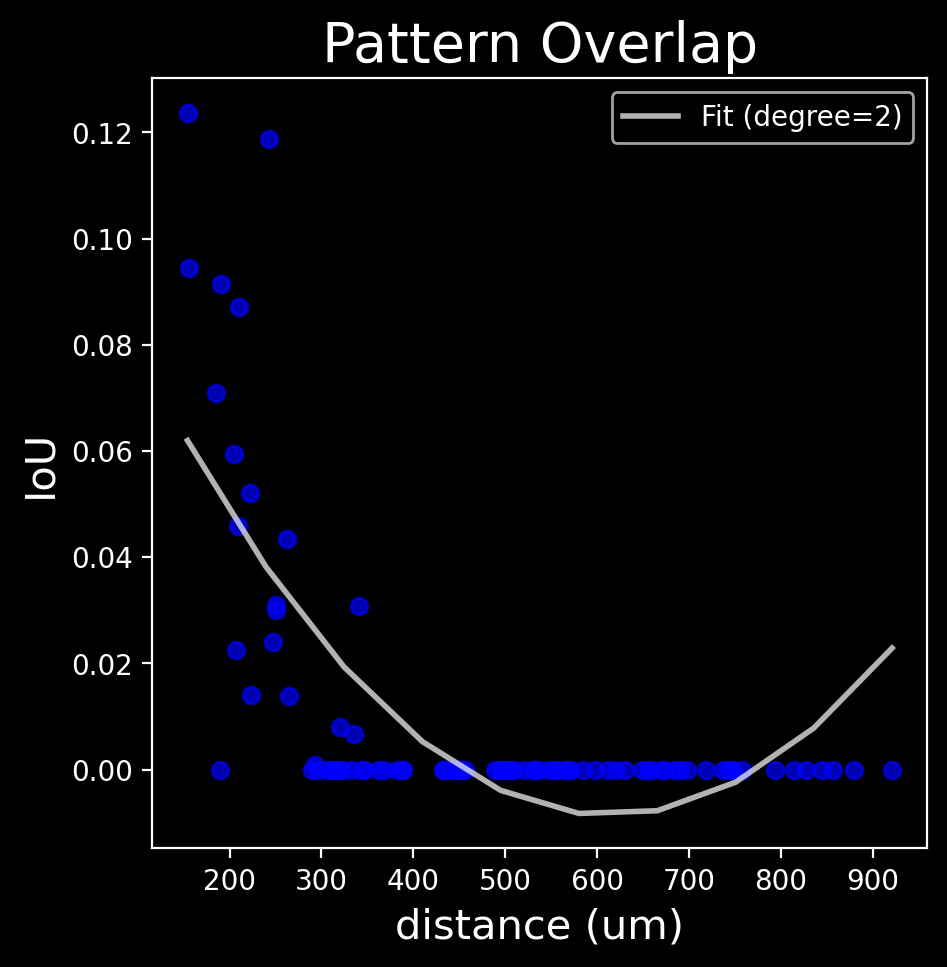

In [123]:
plt.figure(figsize = (5, 5), dpi = 200)
plt.scatter(flat_centroid_dists_um, ious, color='blue', alpha=0.7)

# Fit a polynomial of degree 2 (quadratic) or higher (cubic, etc.)
degree = 2  # Change this to 3 for cubic, 4 for quartic, etc.
poly_fit_iou_coeffs = np.polyfit(flat_centroid_dists_um, ious, degree)

# Generate x values for the fitted curve
poly_fit_x_vals_iou = np.linspace(min(flat_centroid_dists_um), max(flat_centroid_dists_um), 10)                               
                                                                                                                                           
# Generate y values using the polynomial coefficients
poly_fit_y_vals_iou = np.polyval(poly_fit_iou_coeffs, poly_fit_x_vals_iou)

# Plot the polynomial fit
plt.plot(poly_fit_x_vals_iou, poly_fit_y_vals_iou, color='white', label=f'Fit (degree={degree})', linewidth=2, alpha=0.7)

# Add title and labels
plt.title("Pattern Overlap", fontsize=20)
plt.xlabel("distance (um)", fontsize=15)
plt.ylabel("IoU", fontsize=15)
plt.savefig(save_dir_NMF + 'correlation_distance_polyfit.png')

# Add legend
plt.legend()
plt.show()

## Get distance binning and avg ious

In [124]:
bin_means_iou, bin_stds_iou, bins_iou = get_dist_binned_iou(flat_centroid_dists, ious, dist_binning=100)

0.0
100.0
200.0
300.0
400.0
500.0
600.0
700.0
800.0
900.0


In [125]:
np.min(flat_centroid_dists)

15.420932353304456

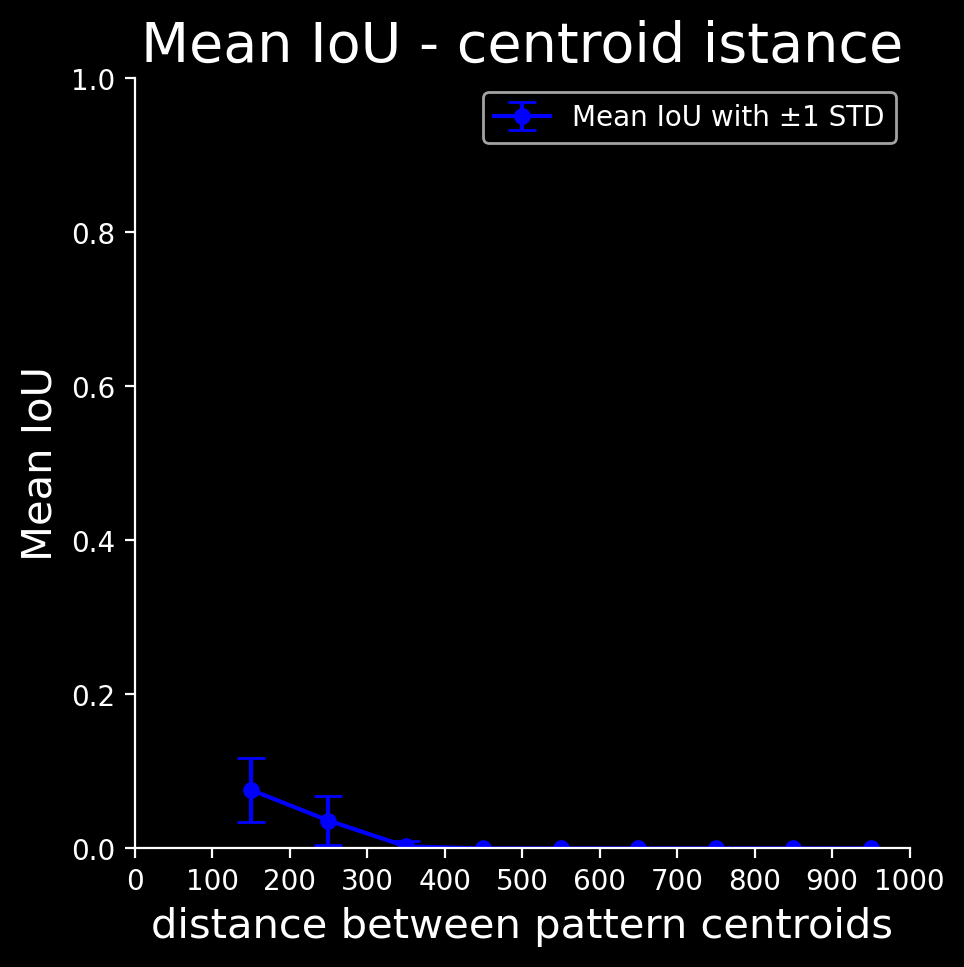

In [126]:
bin_cents_iou = plot_dist_bin_ious(bins_iou, bin_means_iou, bin_stds_iou, save_dir=save_dir_NMF)

In [127]:
flat_centroid_dists.max()

92.11033442475478

## Compute correlations for 10 inside and 10 outside pixels : Within pattern vs in-out pattern pairwise corrs
want to handle the 0 containing rois(which should not exist actually due to min_size thresholding)

In [128]:
def compute_correlations_for_roi(roi_mask, data, n_pixels=None):
    """
    Computes correlations within a given ROI and between inside and outside the ROI.

    Parameters:
    - roi_mask: Binary mask for the ROI, where 1 indicates pixels inside the ROI.
    - data: 2D array of shape (n_timepoints, n_pixels) containing pixel time series data.
    - n_pixels: Number of pixels to randomly select from inside and outside the ROI.

    Returns:
    - corr_within: Correlation matrix for pixels within the ROI.
    - corr_inside_outside_vals: Correlation matrix between inside and outside pixels.
    - inside_idx: Indices of selected inside pixels.
    - outside_idx: Indices of selected outside pixels.
    """
    
    # Flatten the roi_mask to match the shape of the tiff_data
    roi_mask_flat = roi_mask.flatten()
    
    # Get indices of the pixels inside and outside the ROI
    inside_pixels_idx = np.argwhere(roi_mask_flat == 1).flatten()  # Inside ROI
    outside_pixels_idx = np.argwhere(roi_mask_flat == 0).flatten()  # Outside ROI

    # Set n_pixels equal to the number of inside pixels
    n_pixels = len(inside_pixels_idx)

    # Check if there are enough outside pixels for sampling
    if len(outside_pixels_idx) < n_pixels:
        print("Skipping ROI as there are insufficient outside pixels.")
        return None, None, None, None  # Skip this ROI if not enough outside pixels

    # Randomly select n_pixels inside the ROI
    #random_inside_idx = np.random.choice(inside_pixels_idx, n_pixels, replace=False)
    inside_idx = inside_pixels_idx  # All pixels inside the ROI
    
    # Randomly select n_pixels outside the ROI
    outside_idx = np.random.choice(outside_pixels_idx, n_pixels, replace=False)
    
    # Extract the time series of the selected pixels from the data
    inside_pixel_traces = data[:, inside_idx]  # Shape: (n_timepoints, n_pixels)
    outside_pixel_traces = data[:, outside_idx]  # Shape: (n_timepoints, n_pixels)
    
    # Compute pairwise correlation for selected inside pixels (within-ROI correlation)
    corr_within = np.corrcoef(inside_pixel_traces.T)  # Shape: (n_pixels, n_pixels)
    
    # Combine traces for inside and outside pixels
    combined_traces = np.hstack((inside_pixel_traces, outside_pixel_traces))  # Shape: (n_timepoints, 2*n_pixels)
    
    # Compute pairwise correlation between inside and outside pixels
    corr_inside_outside = np.corrcoef(combined_traces.T)  # Shape: (2*n_pixels, 2*n_pixels)
    
    # Extract only the correlation values between inside and outside pixels
    corr_inside_outside_vals = corr_inside_outside[:n_pixels, n_pixels:]  # Shape: (n_pixels, n_pixels)
    
    return corr_within, corr_inside_outside_vals, inside_idx, outside_idx

## Plot also only 10 for display 

C:\Users\zaggila\AppData\Local\Temp\ipykernel_17820\679575588.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('bwr')


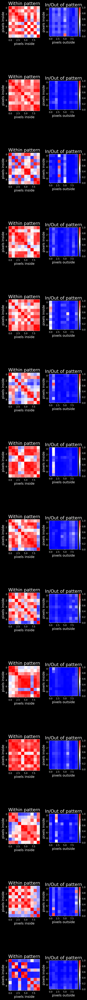

In [129]:
plt.style.use('dark_background')
fig, axs = plt.subplots(len(rois_auto), 2, figsize=(5, 5 * len(rois_auto)), dpi=200)

for i in range(len(rois_auto)):
    roi_mask = rois_auto[i]  # Binary mask for the ith ROI

    # Compute correlations with 10 random pixels inside and outside the ROI
    corr_within, corr_inside_outside_vals, inside_idx, outside_idx = compute_correlations_for_roi_10pxs(roi_mask, data, n_pixels=10)
    
    if corr_within is None:  # Skip if there were not enough pixels
        continue

    # Plot within-ROI correlation

    cmap = cm.get_cmap('bwr')

    axs[i, 0].imshow(corr_within, cmap='bwr', vmin=0, vmax=1)
    axs[i, 0].set_title('Within pattern', fontsize=20)
    axs[i, 0].set_xlabel('pixels inside', fontsize=15)
    axs[i, 0].set_ylabel('pixels inside', fontsize=15)

    # Plot between inside and outside correlation
    img2 = axs[i, 1].imshow(corr_inside_outside_vals, cmap='bwr', vmin=0, vmax=1)
    axs[i, 1].set_title('In/Out of pattern', fontsize=20)
    axs[i, 1].set_xlabel('pixels outside', fontsize=15)
    axs[i, 1].set_ylabel('pixels inside', fontsize=15)
    
    plt.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05, wspace=0.3, hspace=0.3)
    
    fig.colorbar(img2, ax = axs[i,1], fraction=0.046, pad=0.04)

plt.savefig(save_dir_NMF + 'corrs_within_in_out_10pixels.png', bbox_inches='tight')
plt.show()

C:\Users\zaggila\AppData\Local\Temp\ipykernel_17820\3897768465.py:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


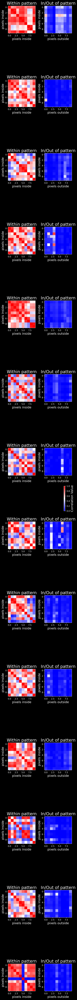

In [130]:
import matplotlib.pyplot as plt

plt.style.use('dark_background')
fig, axs = plt.subplots(len(rois_auto), 2, figsize=(5, 5 * len(rois_auto)), dpi=200)

# Track the last image added to use as a reference for the colorbar
img2 = None

for i in range(len(rois_auto)):
    roi_mask = rois_auto[i]  # Binary mask for the ith ROI

    # Compute correlations with 10 random pixels inside and outside the ROI
    corr_within, corr_inside_outside_vals, inside_idx, outside_idx = compute_correlations_for_roi_10pxs(roi_mask, data, n_pixels=10)
    
    if corr_within is None:  # Skip if there were not enough pixels
        continue

    # Plot within-ROI correlation
    axs[i, 0].imshow(corr_within, cmap='bwr', vmin=0, vmax=1)
    axs[i, 0].set_title('Within pattern', fontsize=20)
    axs[i, 0].set_xlabel('pixels inside', fontsize=15)
    axs[i, 0].set_ylabel('pixels inside', fontsize=15)

    # Plot between inside and outside correlation
    img2 = axs[i, 1].imshow(corr_inside_outside_vals, cmap='bwr', vmin=0, vmax=1)
    axs[i, 1].set_title('In/Out of pattern', fontsize=20)
    axs[i, 1].set_xlabel('pixels outside', fontsize=15)
    axs[i, 1].set_ylabel('pixels inside', fontsize=15)

# Adjust subplot spacing
plt.subplots_adjust(left=0.05, right=0.88, top=0.95, bottom=0.05, wspace=0.3, hspace=0.3)

# Add a single colorbar to the right side of all subplots
cbar = fig.colorbar(img2, ax=axs, orientation='vertical', fraction=0.02, pad=0.02, shrink=0.8)
cbar.set_label('Correlation Value', fontsize=15)  # Add label to the colorbar

plt.tight_layout()
plt.savefig(save_dir_NMF + 'corrs_within_in_out_10pixels_.png', bbox_inches='tight')
plt.show()

## Compute & plot all (len(all pxs) within to equal no. out)

C:\Users\zaggila\AppData\Local\Temp\ipykernel_17820\2234117802.py:19: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


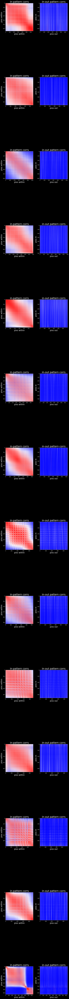

In [131]:
fig, axs = plt.subplots(len(rois_auto), 2, figsize=(10, 10 * n_components), constrained_layout=True)

for i in range(len(rois_auto)):
    roi_mask = rois_auto[i]  # Binary mask for the ith ROI

    # result = compute_correlations_for_roi(roi_mask, data)
    corr_within, corr_inside_outside_vals, inside_idx, outside_idx = compute_correlations_for_roi(roi_mask, data) #changes when run becs pixs chosen are random
 
    axs[i,0].imshow(corr_within, cmap='bwr', vmin=0, vmax=1)
    axs[i,0].set_title('in-pattern corrs', fontsize=25)
    axs[i,0].set_xlabel('pixs within', fontsize=20)
    axs[i,0].set_ylabel('pixs within', fontsize=20)

    axs[i,1].imshow(corr_inside_outside_vals, cmap='bwr', vmin=0, vmax=1)
    axs[i,1].set_title('in-out pattern corrs', fontsize=25)
    axs[i,1].set_xlabel('pixs out', fontsize=20 )
    axs[i,1].set_ylabel('pixs in', fontsize=20)
    # fig.colorbar(im, ax=axs[i,1])
plt.tight_layout()
plt.savefig(save_dir_NMF + 'corrs_within_in_out.png', bbox_inches='tight')

In [132]:
len(corr_within)

846

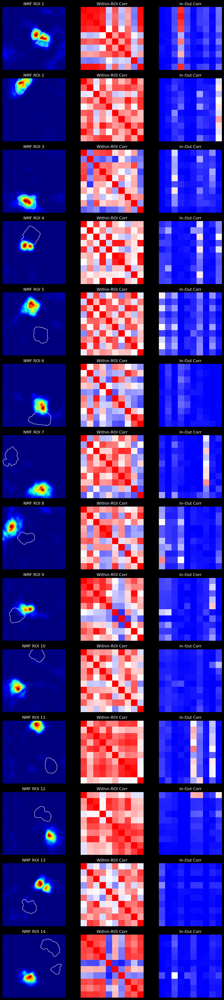

In [133]:
plt.style.use('dark_background')

n_rois = len(rois_auto)
fig, axs = plt.subplots(n_rois, 3, figsize=(12, 3 * n_rois))

for i, roi_mask in enumerate(rois_auto):
    # Compute correlations
    corr_within, corr_inside_outside_vals, inside_idx, outside_idx = compute_correlations_for_roi_10pxs(roi_mask, data, n_pixels=10)

    # Plot NMF loading image or mask
    axs[i, 0].imshow(loading_imgs_filt[i], cmap='jet')
    axs[i, 0].contour(roi_mask, colors='white', linewidths=1)
    axs[i, 0].set_title(f'NMF ROI {i+1}')
    axs[i, 0].axis('off')

    # Plot within-ROI correlation matrix
    if corr_within is not None:
        im1 = axs[i, 1].imshow(corr_within, cmap='bwr', vmin=0, vmax=1) # b is 0, w is 0.5, r is 1
        axs[i, 1].set_title('Within-ROI Corr')
    else:
        axs[i, 1].text(0.5, 0.5, 'N/A', ha='center', va='center')
    axs[i, 1].axis('off')

    # Plot inside-outside ROI correlation matrix
    if corr_inside_outside_vals is not None:
        im2 = axs[i, 2].imshow(corr_inside_outside_vals, cmap='bwr', vmin=0, vmax=1)
        axs[i, 2].set_title('In-Out Corr')
    else:
        axs[i, 2].text(0.5, 0.5, 'N/A', ha='center', va='center')
    axs[i, 2].axis('off')

plt.tight_layout()
fig.subplots_adjust(right=0.88)

# Optionally save
# fig.savefig(save_dir_NMF + '/roi_corr_patterns.png', dpi=300, bbox_inches='tight')
plt.show()

## extract vars to save (mean per upper triangle)

In [134]:
def compute_within_without_pattern_corr(correlations_in , correlations_in_out):
    upper_tri_within = correlations_in[np.triu_indices_from(correlations_in, k=1)]
    upper_tri_in_out = correlations_in_out[np.triu_indices_from(correlations_in_out, k=1)]

    mean_corr_within = np.mean(upper_tri_within)
    mean_corr_in_out = np.mean(upper_tri_in_out)

    return mean_corr_within, mean_corr_in_out

In [135]:
# Initialize lists to store mean correlations for each ROI
mean_corrs_within = []
mean_corrs_in_out = []

# Iterate over the ROIs and calculate mean correlations for each
for i in range(len(rois_auto)):
    roi_mask = rois_auto[i]  # Binary mask for the ith ROI

    # Compute correlations for the current ROI
    corr_within, corr_inside_outside_vals, inside_idx, outside_idx = compute_correlations_for_roi(roi_mask, data)
    
    if corr_within is None or corr_inside_outside_vals is None:
        print(f"Skipping ROI {i} due to insufficient pixels.")
        continue  # Skip if ROI is invalid

    # Compute the mean correlations for the current ROI
    mean_corr_within, mean_corr_in_out = compute_within_without_pattern_corr(corr_within, corr_inside_outside_vals)
    
    # Append the mean values to the lists
    mean_corrs_within.append(mean_corr_within) #mean of all components within
    mean_corrs_in_out.append(mean_corr_in_out) #mean of all components in out 

In [136]:
np.mean(mean_corrs_within)

0.5922013974864507

In [137]:
mean_corrs_within_all_patterns = np.mean(mean_corrs_within)
print(mean_corrs_within_all_patterns)

mean_corrs_in_out_all_patterns = np.mean(mean_corrs_in_out)
print(mean_corrs_in_out_all_patterns)

0.5922013974864507
0.07175982332460416


## time features
1. mean acts frequency
2. pattern frequency, iei, peak width 

In [138]:
#compute the mean activity across pixels
mean_acts = np.mean(data, axis=1)  

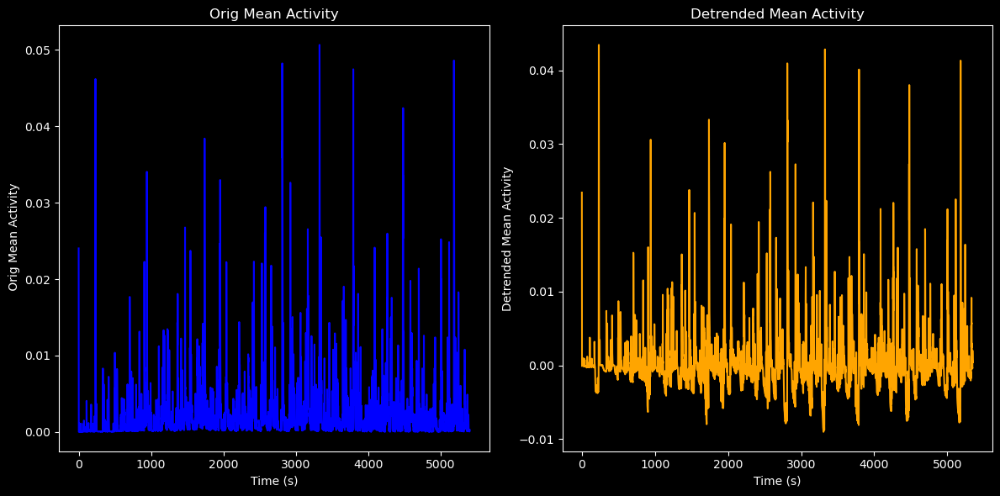

In [139]:
def moving_average(data, window_size):
    return np.convolve(data, np.ones(window_size)/window_size, mode='valid')

window_size = 50 
# Calculate moving average
moving_avg = moving_average(mean_acts, window_size)

# Subtract the moving average from the original signal (detrend)
detrended_mean_acts = mean_acts[:len(moving_avg)] - moving_avg

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(mean_acts, label="Original", color='blue')
plt.title('Orig Mean Activity')
plt.xlabel('Time (s)')
plt.ylabel(' Orig Mean Activity')

plt.subplot(1, 2, 2)
plt.plot(detrended_mean_acts, label="moving average", color='orange')
plt.title('Detrended Mean Activity')
plt.xlabel('Time (s)')
plt.ylabel('Detrended Mean Activity')
plt.savefig(save_dir_NMF + 'detrended_mean_acts.png')

plt.tight_layout()
plt.show()

In [140]:
def threshold_mean_acts(mean_acts, save_dir=None):
    mean_value = np.mean(mean_acts)
    std_value = np.std(mean_acts)
    threshold_mean_acts = mean_value + 1*std_value #same as in behavior for active/inactive 

    mean_acts = gaussian_filter1d(mean_acts, sigma=1)  # Adjust sigma for desired smoothness

    peaks, _ = find_peaks(mean_acts, height=threshold_mean_acts)

    num_peaks_mean_acts = len(peaks)
    mean_frequency_all_rois = num_peaks_mean_acts / duration # freq of peaks per time unit (s)
    print(f'Mean acts frequency is {mean_frequency_all_rois} Hz')
    
    plt.style.use('dark_background')
    plt.figure(figsize=(30, 5))
    plt.plot(mean_acts, color='blue', label='mean acts of all pxs')
    plt.plot(peaks, mean_acts[peaks], "ro", label='Detected Peaks')  # Mark peaks with red dots
    plt.axhline(y=threshold_mean_acts, color='gray', linestyle='--', label='1*std threshold')
    plt.title(f"Mean Activity (Frequency: {mean_frequency_all_rois:.2f} peaks/unit time)", fontsize=30)
    plt.xlabel('time (frames)', fontsize=25)
    plt.ylabel('Mean Pixel Activity', fontsize=25)
    plt.savefig(save_dir + 'peak_detection_mean_acts.png')

    plt.legend()

    return mean_frequency_all_rois

## Mean or Detrended ?

Mean acts frequency is 0.056666666666666664 Hz


3.4

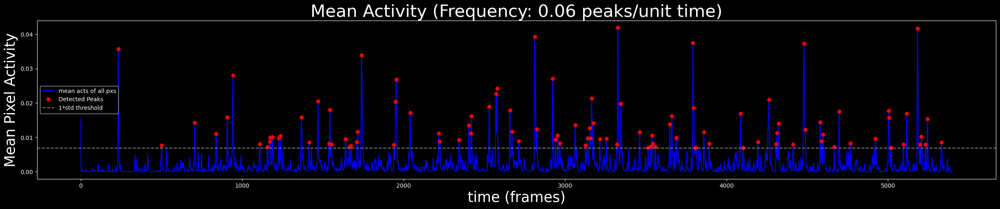

In [141]:
mean_frequency_all_acts = threshold_mean_acts(mean_acts, save_dir=save_dir_NMF)
mean_frequency_all_acts_per_min = mean_frequency_all_acts *60
mean_frequency_all_acts_per_min

In [142]:
mean_frequency_all_acts_per_min

3.4

In [143]:
# mean_frequency_all_acts = threshold_mean_acts(mean_acts, save_dir=save_dir_NMF)
# mean_frequency_all_acts_per_min = mean_frequency_all_acts *60
# mean_frequency_all_acts_per_min

## Compute time features of each pattern 

 Frequency: 0.016666666666666666 events/sec
 Frequency: 0.018333333333333333 events/sec
 Frequency: 0.028888888888888888 events/sec
 Frequency: 0.017222222222222222 events/sec
 Frequency: 0.020555555555555556 events/sec
 Frequency: 0.02 events/sec
 Frequency: 0.025555555555555557 events/sec
 Frequency: 0.017777777777777778 events/sec
 Frequency: 0.02277777777777778 events/sec
 Frequency: 0.027777777777777776 events/sec
 Frequency: 0.01888888888888889 events/sec
 Frequency: 0.026111111111111113 events/sec
 Frequency: 0.025555555555555557 events/sec
 Frequency: 0.020555555555555556 events/sec
Average firing frequency for this dataset is 0.021904761904761903
Average inter-event interval for this dataset is 47.15535785627072 sec probably
Average peak width for this dataset is 0.15300986893931323 sec


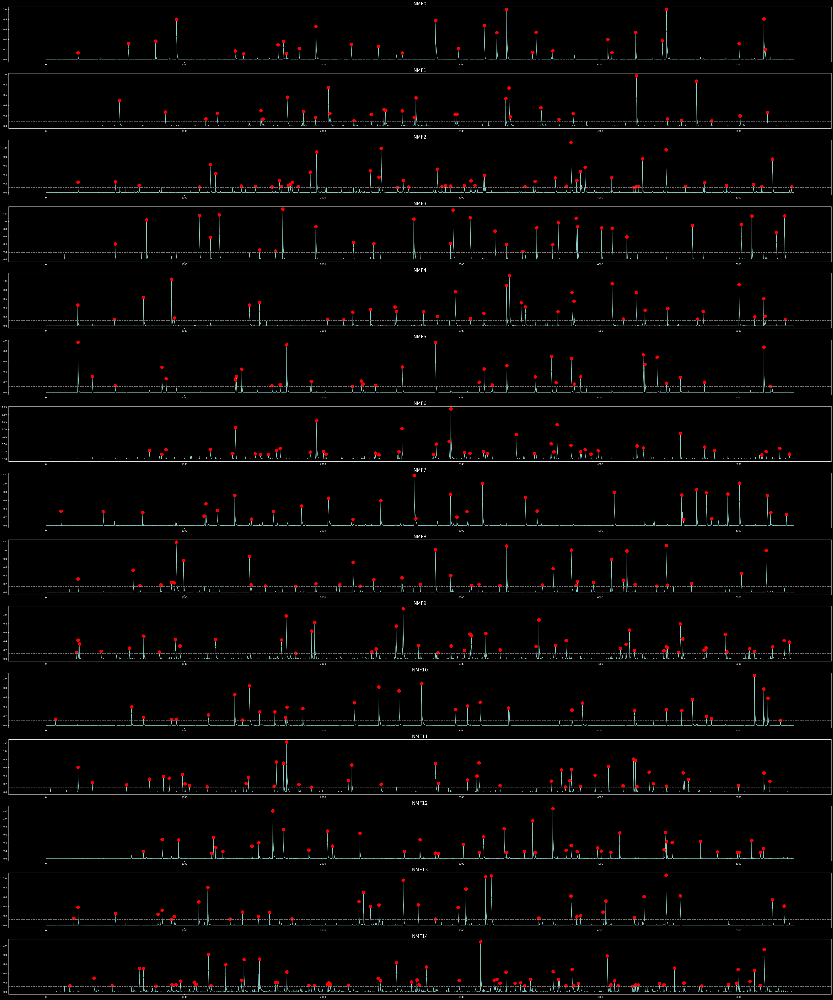

In [144]:
peak_counts = []
f_events_per_comp = []
ieis_per_component = []
inter_event_intervals = []
mean_widths_per_component = []
all_peak_widths_frames = []
all_peak_widths_secs = []

fig, axes = plt.subplots(n_components, 1, figsize=(50, 60))
axes = axes.ravel()

for i in range(n_components):
    time_component = H.T[i]
    axes[i].plot(time_component)
    axes[i].set_title(f'NMF{i}', color='white', fontsize=20)
    
    axes[i].tick_params(axis='x', colors='white')
    axes[i].tick_params(axis='y', colors='white')
    axes[i].xaxis.label.set_color("white")
    axes[i].yaxis.label.set_color("white")
    
    # Compute standard deviation and threshold for peak detection
    std_dev = np.std(time_component)
    threshold = 2 * std_dev  # Adjust as needed
    
    # Find peaks with a specified minimum distance between peaks
    peaks, properties = find_peaks(time_component, height=threshold, distance=10)
    
    # Plot detected peaks
    axes[i].plot(peaks, time_component[peaks], "ro", markersize=14)
    
    # Plot horizontal line at threshold
    axes[i].axhline(y=threshold, linestyle='--', linewidth=2, color='gray')
    
    # Measure peak widths at half height
    results_half = peak_widths(time_component, peaks, rel_height=0.5)
    widths = results_half[0]
    left_ips = results_half[2]
    right_ips = results_half[3]

    # Collect all peak widths
    all_peak_widths_frames.extend(widths)
    all_peak_widths_secs.extend(widths * time_per_frame)
    
    # Plot peak widths
    for j in range(len(peaks)):
        axes[i].hlines(y=time_component[peaks[j]] - (time_component[peaks[j]] - threshold) / 2, 
                       xmin=left_ips[j], xmax=right_ips[j], 
                       colors="green", linestyle="--")
    
    # Compute mean peak width for the component
    mean_width = np.mean(widths)
    #print(f'Mean peak width for component {i} is {mean_width}')
    
    # Count the number of detected peaks
    num_peaks = len(peaks)
    
    # Compute frequency of events
    f_events = (num_peaks) / (duration) 
    #print(f'Event frequency for component {i} is {f_events} events/sec')
       
    # Filter out components with high event frequency or too low 
    if  frequency_min_thresh <= f_events <= frequency_max_thresh:
 
        f_events_per_comp.append(f_events)
        print(f' Frequency: {f_events_per_comp[-1]} events/sec')
        mean_widths_per_component.append(mean_width)
        peak_counts.append(num_peaks)
    
        # Compute inter-event interval (IEI) as 1/f
        if num_peaks > 0:
            inter_event_interval = duration / num_peaks
        else:
            inter_event_interval = np.nan  # Handle division by zero if no peaks are found
        #print(f'IEI for component {i} is {inter_event_interval} sec')
        
        ieis_per_component.append(inter_event_interval)

mean_frequency_all_patterns = np.mean(f_events_per_comp)
mean_iei_all_patterns = np.mean([iei for iei in ieis_per_component if not np.isnan(iei)])
mean_width_all_patterns = np.mean(mean_widths_per_component)
mean_frequency_all_patterns_per_min= mean_frequency_all_patterns * 60 

print(f'Average firing frequency for this dataset is {mean_frequency_all_patterns}')
print(f'Average inter-event interval for this dataset is {mean_iei_all_patterns} sec probably')
print(f'Average peak width for this dataset is {mean_width_all_patterns*time_per_frame} sec')

# Plot the results
plt.tight_layout()
plt.show()

In [145]:
filtered_h.shape

(14, 5400)

## Cross correlation between H traces 

In [146]:
# from scipy.signal import correlate
# n_traces = filtered_h.shape[0]

# # Iterate through each component
# mean_cross_corrs = []
# for i in range(n_traces):
#     for j in range(n_traces):
#         if i == j:
#             continue

#         # Compute cross-correlation with the filtered_h
#         cross_corr = correlate(filtered_h[i],filtered_h[j], mode='full')
#         mean_cross_corr = np.mean(cross_corr)  # Calculate mean cross-correlation
#         mean_cross_corrs.append(mean_cross_corr)
        
#         # Normalize the cross-correlation for plotting
#         cross_corr /= np.max(np.abs(cross_corr))  # Normalize to the range [-1, 1]

#         plt.figure(figsize=(5, 5), dpi=200)
#         lags = np.argmax(cross_corr) # Lags for x-axis
#         plt.plot(lags, cross_corr, color='magenta')
#         plt.title(f'Cross-Correlation between Component {i+1} and Component {j+1}', fontsize=16)
#         plt.axhline(0, color='black', lw=1, ls='--')
#         plt.xlabel('Lag', fontsize=12)
#         plt.ylabel('Cross-Correlation', fontsize=12)
#         plt.show()

## H.T

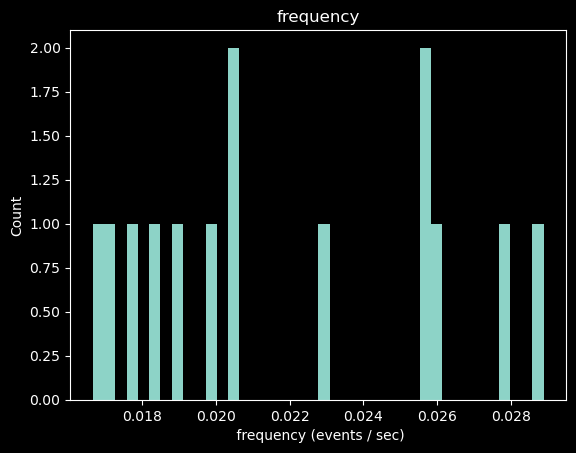

In [147]:
plt.hist(f_events_per_comp, bins=40)
plt.title('frequency')
plt.xlabel(' frequency (events / sec)')
plt.ylabel('Count')
plt.show()

In [148]:
def plot_peak_widths(all_peak_widths_frames, all_peak_widths_secs):
        
    fig, axes = plt.subplots(2, 1, figsize=(12, 12))
    
    # Plot peak widths in frames
    sns.histplot(all_peak_widths_frames, kde=True, bins=50, ax=axes[0])
    axes[0].set_xlabel('Peak Width (frames)')
    axes[0].set_ylabel('Frequency (Hz)')
    
    # Compute KDE for peak widths in frames
    kde_frames = gaussian_kde(all_peak_widths_frames, bw_method='scott')
    x_frames = np.linspace(min(all_peak_widths_frames), max(all_peak_widths_frames), 1000)
    kde_values_frames = kde_frames(x_frames)
    
    # Plot the KDE for frames
    axes[0].plot(x_frames, kde_values_frames, color='red')
    
    # Find local maxima and minima for frames
    peaks_frames, _ = find_peaks(kde_values_frames)
    minima_frames, _ = find_peaks(-kde_values_frames)
    
    # Plot local maxima for frames
    axes[0].plot(x_frames[peaks_frames], kde_values_frames[peaks_frames], "ro", markersize=8, label='Maxima')
    
    # Plot local minima for frames
    axes[0].plot(x_frames[minima_frames], kde_values_frames[minima_frames], "go", markersize=8, label='Minima')
    
    # Plot peak widths in seconds
    sns.histplot(all_peak_widths_secs, kde=True, bins=50, ax=axes[1])
    axes[1].set_xlabel('Peak Width (sec)')
    axes[1].set_ylabel('Frequency (Hz)')

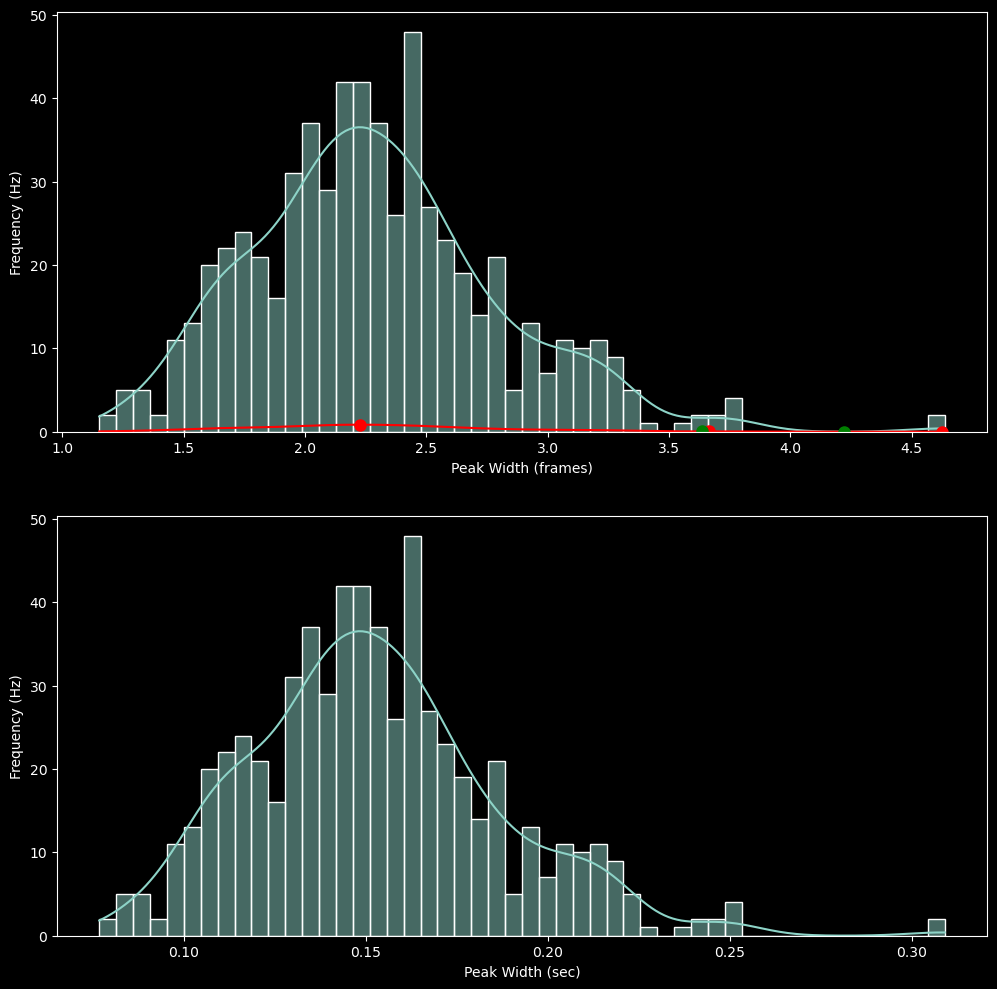

In [149]:
plot_peak_widths(all_peak_widths_frames, all_peak_widths_secs)

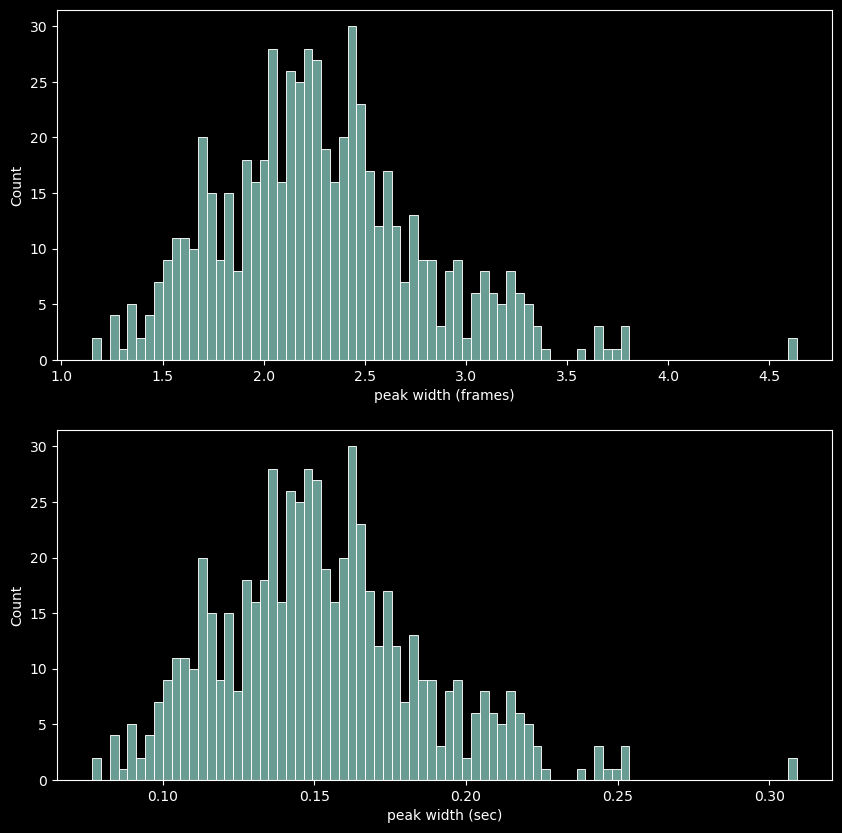

In [150]:
fig, axs = plt.subplots(2,1, figsize=(10,10))

sns.histplot(all_peak_widths_frames, kde=False, bins=80, ax=axs[0])
axs[0].set_xlabel('peak width (frames)')

sns.histplot(all_peak_widths_secs, kde=False, bins=80, ax =axs[1])
axs[1].set_xlabel('peak width (sec)')

fig.savefig(save_dir_NMF + 'peak_widths.png', bbox_inches="tight")
plt.show()

In [151]:
mean_peak_width_all_patterns = np.mean(all_peak_widths_secs)

In [152]:
mean_peak_width_all_patterns

0.15249498490346297

## Only including ones we keep (not ttoo frequent ones)

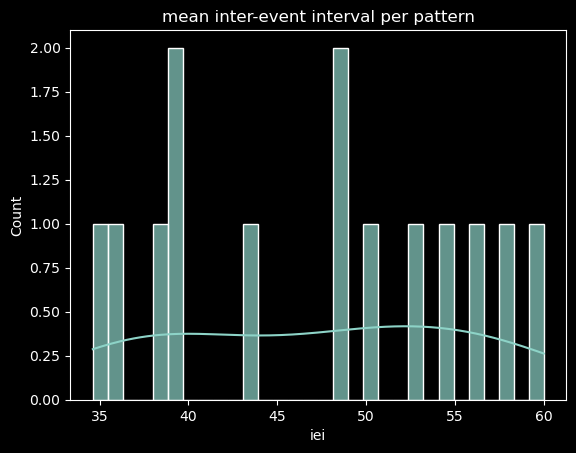

In [153]:
sns.histplot(ieis_per_component, bins=30, alpha=0.7, kde=True)
plt.title('mean inter-event interval per pattern')
plt.xlabel('iei')
fig.savefig(save_dir_NMF + 'mean_iei.png', bbox_inches="tight")

plt.show()

## export / animate 

In [154]:
# reshaped_data = data.reshape([data.shape[0], int(np.sqrt(data.shape[1])), int(np.sqrt(data.shape[1]))]).copy() #copy() to not rewrite data 

# for i in range(n_components):
#     for largest_roi in conts[i]:
#         reshaped_data[:, largest_roi[:, 0].astype(int),largest_roi[:, 1].astype(int)] = 1
# output_filename = os.path.join(save_dir_NMF, 'roi_movie.tif')
# tifffile.imwrite(save_dir_NMF, reshaped_data)

In [155]:
export_conts_fiji(conts, save_dir_NMF)

In [156]:
# plt.rcParams["animation.html"] = "jshtml"
# plt.rcParams['figure.dpi'] = 100
# plt.ioff()

# fig = plt.figure()
# frame_count = reshaped_data.shape[0]

# fig = plt.figure()

# # update the plot for each frame
# def update(frame):
#     plt.clf()
#     plt.imshow(reshaped_data[frame])
#     plt.title('Frame {}'.format(frame))
#     plt.axis('off')

# # Create the animation
# ani = animation.FuncAnimation(fig, update, repeat=False, frames=frame_count, interval=time_per_frame*100, save_count = frame_count) # interval is delay in msec, play at 10x speed 
# plt.show()
# # Save anim
# output_filename = os.path.join(save_dir_NMF, 'roi_anim.mp4') #limit of func anim at 1000 frames, can be fixed
# ani.save(output_filename, writer='ffmpeg', fps=5)  # Adjust FPS as needed

In [157]:
# import matplotlib.animation as animation

# plt.rcParams["animation.html"] = "jshtml"
# # plt.rcParams['figure.dpi'] = 150
# plt.rcParams['figure.dpi'] = 100
# plt.ioff()

# frame_count = reshaped_data.shape[0]

# fig = plt.figure()

# # Function to update the plot for each frame
# def update(frame):
#     plt.clf()
#     plt.imshow(reshaped_data[frame])
#     plt.title('Frame {}'.format(frame))
#     plt.axis('off')

# # Create the animation
# ani = animation.FuncAnimation(fig, update, repeat=False, frames=frame_count, interval=time_per_frame*100, save_count = frame_count) # interval is delay in msec, play at 10x speed 

# # Save anim
# output_filename = os.path.join(save_dir_NMF, 'roi_anim.mp4') #limit of func anim at 1000 frames, can be fixed

# anifilename = os.path.join(save_dir_NMF, 'roi_anim.mp4') #limit of func anim at 1000 frames, can be fixed

# ani

In [158]:
filtered_w.shape

(14, 12769)

In [159]:
W.shape

(15, 12769)

In [160]:
# variables to save
pixel_nmf_exp = {'ds': ds,
                 'n_components': n_components, #all components (initial cv estimate) 
                 'norm_components':norm_components, # normalized no of comper per 500 squared um
                 'W matrix': W, # W matrix - spatial components 
                 'H matrix': H, # H matrix - temporal traces of components 
                 'total_area': total_area, # ttal area of FOV
                 'min_size':min_size, #min size on bin for keeping patterns 
                 'max_size':max_size, #max_size on bin for keeping patterns 
                 'filtered_pattern_idxs' : filtered_rois_idxs, 
                 'filtered_rois_auto' : filtered_rois_auto, # w mask of filtered 'good' patterns
                 'filtered_temporal_rois_auto' : filtered_h,  # h temp traces of filtered 'good' patterns 
                 'rois_auto': rois_auto, #boolean masks of all patterns
                 'all_roi_areas' : all_roi_areas, #has been filtered from here onwards
                 'mean_all_roi_areas': mean_area_all,
                 'all_roi_areas_disconnected' : all_roi_areas_disconnected, #like M-assembly sizes of eahc part
                 'non_border_roi_areas' : non_border_roi_areas, #non_border_roi_areas per pattern, 
                 'mean_areas_borders_out' : mean_non_border_roi_areas, # mean of non border roi areas across patterns 
                 'flat_centroid_distances_in_um': flat_centroid_dists_um, #distances in um
                 'flat_pattern_correlations_sum_pix': flattened_correlations_sumpix, #correlations 
                 'bin_means_corr' : bin_means_corr, # binned means 
                 'bin_stds_corr': bin_stds_corr, #binned stds
                 'bin_cents_corr' : bin_cents_corr, #binned centers
                 'bins_corr' : bins_corr, #binned correlations (causes some NA issue)
                 'poly_fit_x_vals_corr' : poly_fit_x_vals_corr, 
                 'poly_fit_y_vals_corr': poly_fit_y_vals_corr,
                 'corr_dist_polynomial_coefficients': poly_fit_corr_coeffs,
                 'ious_mat' : ious_mat,
                 'ious' : ious, #ious correlations (same distances as for corr)
                 'mean_iou' : mean_iou, #mean IoU for all patterns 
                 'ious_filt': ious_filt, 
                 'ious_filt_mean':ious_filt_mean,
                 'bin_means_iou' : bin_means_iou, #binned iou as fucntion of centroid distance 
                 'bin_stds_iou': bin_stds_iou, #binned iou std as function of centroid distance 
                 'bin_cents_iou' : bin_cents_iou, #may be needed for plotting ?
                 'bins_iou' : bins_iou, #bins for iou
                 'poly_fit_x_vals_iou': poly_fit_x_vals_iou, 
                 'poly_fit_y_vals_iou': poly_fit_y_vals_iou,
                 'poly_fit_iou_coeffs': poly_fit_iou_coeffs,
                 'peak_counts' : peak_counts, 
                 'corr_pxs_within': corr_within, # corr between pixels within patch, 
                 'corr_pxs_in_out': corr_inside_outside_vals, #corr pxs in-out of patch , add binned avg corrs and distance ?
                 'mean_per_pattern_corr_within' : mean_corrs_within, #mean between comps (upper triangle for each comp) 
                 'mean_per_pattern_corr_in_out' : mean_corrs_in_out, #mean in-out pixels for each comp (upper traingle for equal values)
                 'mean_corrs_within_all_patterns': mean_corrs_within_all_patterns,
                 'mean_corrs_in_out_all_patterns':mean_corrs_in_out_all_patterns,
                 'mean_frequency_all_acts' : mean_frequency_all_acts,
                 'mean_frequency_all_acts_per_min': mean_frequency_all_acts_per_min,
                 'f_events_per_comp' : f_events_per_comp,
                 'ieis_per_component' : ieis_per_component,
                 'mean_frequency_all_patterns' : mean_frequency_all_patterns,
                 'mean_frequency_all_patterns_per_min': mean_frequency_all_patterns_per_min,
                 'mean_iei_all_patterns' : mean_iei_all_patterns,
                 'mean_width_all_patterns' : mean_width_all_patterns,
                 'all_peak_widths_frames' : all_peak_widths_frames, 
                 'all_peak_widths_secs': all_peak_widths_secs, 
                 'mean_peak_width_all_patterns': mean_peak_width_all_patterns,

} 

np.save(f'{save_dir}/pixel_nmf_exp.npy', pixel_nmf_exp, allow_pickle=True)

In [161]:
all_roi_areas

[65666.93210118254,
 56399.82332210822,
 61780.725193828795,
 70051.37066332523,
 59787.79857467303,
 77126.2601613282,
 62577.8958414911,
 46634.48288824496,
 52712.909076670054,
 45339.080585793716,
 45638.01957866708,
 49723.5191479364,
 46933.421881118324,
 84300.79599028897]

In [162]:
x_axis

113

In [163]:
len(filtered_rois_auto)

14

In [164]:
# variables to save
pixel_nmf_exp = {'ds': ds,
                 'x_axis_downs': x_axis, 
                 'y_axis_downs': y_axis,
                 'n_components': n_components, #all components (initial cv estimate) 
                 'norm_components':norm_components, # normalized no of comper per 500 squared um
                 'W matrix': W, # W matrix - spatial components 
                 'H matrix': H, # H matrix - temporal traces of components 
                 'total_area': total_area, # ttal area of FOV
                 'min_size':min_size, #min size on bin for keeping patterns 
                 'max_size':max_size, #max_size on bin for keeping patterns 
                 'filtered_pattern_idxs' : filtered_rois_idxs, 
                 'filtered_rois_auto' : filtered_rois_auto, # w mask of filtered 'good' patterns
                 'filtered_temporal_rois_auto' : filtered_h,  # h temp traces of filtered 'good' patterns 
                 'rois_auto': rois_auto, #boolean masks of all patterns
                 'all_roi_areas' : all_roi_areas, #has been filtered from here onwards
                 'mean_all_roi_areas': mean_area_all,
                 'all_roi_areas_disconnected' : all_roi_areas_disconnected, #like M-assembly sizes of eahc part
                 'non_border_roi_areas' : non_border_roi_areas, #non_border_roi_areas per pattern, 
                 'mean_areas_borders_out' : mean_non_border_roi_areas, # mean of non border roi areas across patterns 
                 'flat_centroid_distances_in_um': flat_centroid_dists_um, #distances in um
                 # 'flat_pattern_correlations_sum_pix': flattened_correlations_sumpix, #correlations 
                 # 'bin_means_corr' : bin_means_corr, # binned means 
                 # 'bin_stds_corr': bin_stds_corr, #binned stds
                 # 'bin_cents_corr' : bin_cents_corr, #binned centers
                 # 'bins_corr' : bins_corr, #binned correlations (causes some NA issue)
                 # 'poly_fit_x_vals_corr' : poly_fit_x_vals_corr, 
                 # 'poly_fit_y_vals_corr': poly_fit_y_vals_corr,
                 # 'corr_dist_polynomial_coefficients': poly_fit_corr_coeffs,
                 'ious_mat' : ious_mat,
                 'ious' : ious, #ious correlations (same distances as for corr)
                 'mean_iou' : mean_iou, #mean IoU for all patterns 
                 'ious_filt': ious_filt, 
                 'ious_filt_mean':ious_filt_mean,
                 'bin_means_iou' : bin_means_iou, #binned iou as fucntion of centroid distance 
                 'bin_stds_iou': bin_stds_iou, #binned iou std as function of centroid distance 
                 'bin_cents_iou' : bin_cents_iou, #may be needed for plotting ?
                 'bins_iou' : bins_iou, #bins for iou
                 'poly_fit_x_vals_iou': poly_fit_x_vals_iou, 
                 'poly_fit_y_vals_iou': poly_fit_y_vals_iou,
                 'poly_fit_iou_coeffs': poly_fit_iou_coeffs,
                 'peak_counts' : peak_counts, 
                 'corr_pxs_within': corr_within, # corr between pixels within patch, 
                 'corr_pxs_in_out': corr_inside_outside_vals, #corr pxs in-out of patch , add binned avg corrs and distance ?
                 'mean_per_pattern_corr_within' : mean_corrs_within, #mean between comps (upper triangle for each comp) 
                 'mean_per_pattern_corr_in_out' : mean_corrs_in_out, #mean in-out pixels for each comp (upper traingle for equal values)
                 'mean_corrs_within_all_patterns': mean_corrs_within_all_patterns,
                 'mean_corrs_in_out_all_patterns':mean_corrs_in_out_all_patterns,
                 'mean_frequency_all_acts' : mean_frequency_all_acts,
                 'mean_frequency_all_acts_per_min': mean_frequency_all_acts_per_min,
                 'f_events_per_comp' : f_events_per_comp,
                 'ieis_per_component' : ieis_per_component,
                 'mean_frequency_all_patterns' : mean_frequency_all_patterns,
                 'mean_frequency_all_patterns_per_min': mean_frequency_all_patterns_per_min,
                 'mean_iei_all_patterns' : mean_iei_all_patterns,
                 'mean_width_all_patterns' : mean_width_all_patterns,
                 'all_peak_widths_frames' : all_peak_widths_frames, 
                 'all_peak_widths_secs': all_peak_widths_secs, 
                 'mean_peak_width_all_patterns': mean_peak_width_all_patterns,

} 

np.save(f'{save_dir}/pixel_nmf_exp.npy', pixel_nmf_exp, allow_pickle=True)

In [165]:
save_dir

'data_proc/pixels/sz119/2025_06_08_a'

# Save setting to nan undefined vars (temp solution: to solve, due to memory issue)

In [166]:
# # List of variable names
# variable_names = [
#     'ds', 'n_components', 'norm_components', 'W matrix', 'H matrix', 'total_area', 'min_size', 'max_size', 
#     'filtered_rois_idxs', 'filtered_rois_auto', 'filtered_temporal_rois_auto', 'rois_auto', 
#     'all_roi_areas', 'mean_all_roi_areas', 'all_roi_areas_disconnected', 'non_border_roi_areas', 
#     'mean_areas_borders_out', 'flat_centroid_distances_in_um', 'flat_pattern_correlations_sum_pix', 
#     'bin_means_corr', 'bin_stds_corr', 'bin_cents_corr', 'bins_corr', 'poly_fit_x_vals_corr', 
#     'poly_fit_y_vals_corr', 'corr_dist_polynomial_coefficients', 'ious_mat', 'ious', 'mean_iou', 
#     'ious_filt', 'ious_filt_mean', 'bin_means_iou', 'bin_stds_iou', 'bin_cents_iou', 'bins_iou', 
#     'poly_fit_x_vals_iou', 'poly_fit_y_vals_iou', 'poly_fit_iou_coeffs', 'peak_counts', 
#     'corr_pxs_within', 'corr_pxs_in_out', 'mean_per_pattern_corr_within', 'mean_per_pattern_corr_in_out', 
#     'mean_corrs_within_all_patterns', 'mean_corrs_in_out_all_patterns', 'mean_frequency_all_acts', 
#     'mean_frequency_all_acts_per_min', 'f_events_per_comp', 'ieis_per_component', 
#     'mean_frequency_all_patterns', 'mean_frequency_all_patterns_per_min', 'mean_iei_all_patterns', 
#     'mean_width_all_patterns', 'all_peak_widths_frames', 'all_peak_widths_secs', 'mean_peak_width_all_patterns'
# ]

# # Create dictionary, assigning np.nan to undefined variables
# pixel_nmf_exp = {}
# for var in variable_names:
#     pixel_nmf_exp[var] = globals().get(var, np.nan)

# # Save dictionary
# np.save(f'{save_dir}/pixel_nmf_exp.npy', pixel_nmf_exp, allow_pickle=True)